# Calibration in wavelength of the  spectra of CTIO Data June 2017
==================================================================================================

- author : Sylvie Dagoret-Campagne
- affiliation : LAL/IN2P3/CNRS FRANCE
- update   : 4th July 2017



- calibrate in wavelength
- Compute uncentainty

In [5]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [6]:
print theNotebook

CalibrateSpectrum


In [7]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import matplotlib as mpl
from astropy.modeling import models
from astropy import units as u
from astropy import nddata
from astropy.io import fits
import re
import os

In [8]:
from matplotlib.backends.backend_pdf import PdfPages

In [9]:
from scipy import stats  
from scipy import ndimage
from datetime import datetime, timedelta
from mpl_toolkits.mplot3d import Axes3D
import scipy.signal

In [10]:
import photutils
from astropy.stats import sigma_clipped_stats
from photutils import daofind
from photutils import CircularAperture
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
#from photutils.background import Background2D
from photutils import Background2D, SigmaClip, MedianBackground

In [11]:
import sys
sys.path.append("../../common_tools/")
from scan_holo import *

In [12]:
%load_ext Cython

In [13]:
from IPython.display import Image, display

In [14]:
import matplotlib
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 

In [15]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (4, 4),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [16]:
%config InlineBackend.rc = {}
matplotlib.rc_file("../../templates/matplotlibrc")

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/matplotlib/__init__.py:913: UserWarning: axes.color_cycle is deprecated and replaced with axes.prop_cycle; please use the latter.
  warnings.warn(self.msg_depr % (key, alt_key))


In [17]:
############################################################################
def ensure_dir(f):
    d = os.path.dirname(f)
    if not os.path.exists(f):
        os.makedirs(f)
#########################################################################

### Output directory for images generated in the notebook view (not true fits images)

In [18]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images

In [19]:
ensure_dir(dir_top_images) # create that directory

### Input fits file

In [20]:
inputdir="./spectrum_fitsspec"
MIN_IMGNUMBER=135
MAX_IMGNUMBER=303
object_name='HD185975_HD205905 June 10th'
SelectTagRe='^finalSpectra_20170610_([0-9]+).fits$' # regular expression to select the file
SearchTagRe='^finalSpectra_20170610_[0-9]+.fits$'
NBIMGPERROW=2

### Output fits file

In [21]:
outputdir="./spectrum_calibspec"

In [22]:
ensure_dir(outputdir)

## Location of corrected images
----------------------------------

In [23]:
input_filelist=os.listdir(inputdir) 

In [24]:
if '.DS_Store' in input_filelist:
    input_filelist.remove('.DS_Store')
input_filelist=np.array(input_filelist)

In [25]:
print input_filelist[0:5]

['finalSpectra_20170610_139.fits' 'finalSpectra_20170610_140.fits'
 'finalSpectra_20170610_141.fits' 'finalSpectra_20170610_142.fits'
 'finalSpectra_20170610_143.fits']


In [26]:
indexes_files= [] # global list
filelist_fitsimages= []  # global list

In [27]:
#%%cython

import numpy as np
import re

def MakeFileList(inputdir,input_filelist):
    """
    MakeFileList : Make The List of files to open
    =============
    """
    
#    import numpy as np
#    import re
    indexes_files= [] # global list
    filelist_fitsimages= []  # global list

    for file in input_filelist: # loop on directories, one per image       
            filename=inputdir+'/'+file
            if re.search('.*fits$',filename):  #example of filename filter
                num_str=re.findall(SelectTagRe,file)[0]
                index=int(num_str)
                filelist_fitsimages.append(filename)
                indexes_files.append(index)
    return indexes_files, filelist_fitsimages

In [28]:
indexes_files, filelist_fitsimages=MakeFileList(inputdir,input_filelist)   # filter to select fits file only

In [29]:
# transform into numpy arrays
indexes_files=np.array(indexes_files)
filelist_fitsimages=np.array(filelist_fitsimages)

In [30]:
print indexes_files

[139 140 141 142 143 144 145 146 151 152 153 154 155 156 157 158 163 164
 165 166 167 168 169 170 175 176 177 178 179 180 181 182 187 188 189 190
 191 192 193 194 199 200 201 202 203 204 205 206 211 212 213 214 215 216
 217 218 223 224 225 226 227 228 229 230 235 236 237 238 239 240 241 242
 247 248 249 250 251 252 253 254 259 260 261 262 263 264 265 266 271 272
 273 274 275 276 277 278 283 284 285 286 287 288 289 290 295 296 297 298
 299 300 301 302]


In [31]:
sorted_indexes=np.argsort(indexes_files) # sort the file indexes

In [32]:
sorted_numbers=indexes_files[sorted_indexes]

In [33]:
print sorted_indexes

[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111]


In [34]:
#sorted_files= [filelist_fitsimages[index] for index in sorted_indexes] # sort files
sorted_files=filelist_fitsimages[sorted_indexes]

In [35]:
sorted_files[0:5]

array(['./spectrum_fitsspec/finalSpectra_20170610_139.fits',
       './spectrum_fitsspec/finalSpectra_20170610_140.fits',
       './spectrum_fitsspec/finalSpectra_20170610_141.fits',
       './spectrum_fitsspec/finalSpectra_20170610_142.fits',
       './spectrum_fitsspec/finalSpectra_20170610_143.fits'], 
      dtype='|S50')

## Build full filename
----------------------------

In [36]:
sorted_filenames=[]
for file in sorted_files:
    #fullfilename=os.path.join(inputdir,file)
    fullfilename=file
    sorted_filenames.append(fullfilename)

In [37]:
#sorted_filenames=np.array(sorted_filenames)
sorted_filenames=np.copy(sorted_files)

In [38]:
print sorted_filenames.shape

(112,)


## Acces to spectrum data
----------------------------------

In [39]:
%%cython

import numpy as np
from astropy.io import fits

def BuildRawSpec(sorted_filenames,sorted_numbers,object_name):
    """
    BuildRawSpec
    ===============
    """

    all_dates = []
    all_airmass = []
    all_leftspectra = []
    all_rightspectra = []
    all_totleftspectra = []
    all_totrightspectra = []
    all_titles = []
    all_header = []
    all_expo = []
    all_filt= []
    all_filt1= []
    all_filt2= []
    all_elecgain = []
    all_obj = []
   
    NBFILES=sorted_filenames.shape[0]

    for idx in range(NBFILES):  
        
        file=sorted_filenames[idx]    
        
        hdu_list=fits.open(file)
        header=hdu_list[0].header
        #print header
        date_obs = header['DATE-OBS']
        airmass = header['AIRMASS']
        expo = header['EXPTIME']
        num=sorted_numbers[idx]
        
        filters = header['FILTERS'].split(' ')[1]
        filters1= header['FILTER1']
        filters2= header['FILTER2']
        obj=header['OBJECT']
        filters= obj+' + '+filters1 + ' + ' + filters2
        
        
        title=object_name+" z= {:3.2f} Nb={}".format(float(airmass),num)
        gain = 0.25*(float(header['GTGAIN11'])+float(header['GTGAIN12'])+float(header['GTGAIN21'])+float(header['GTGAIN22']))
        
        # now reads the spectra
        
        table_data=hdu_list[1].data
        
        left_spectrum=table_data.field('RawLeftSpec')
        right_spectrum=table_data.field('RawRightSpec')
        tot_left_spectrum=table_data.field('TotLeftSpec')
        tot_right_spectrum=table_data.field('TotRightSpec')
        
        all_dates.append(date_obs)
        all_airmass.append(float(airmass))
        all_leftspectra.append(left_spectrum)
        all_rightspectra.append(right_spectrum)
        all_totleftspectra.append(tot_left_spectrum)
        all_totrightspectra.append(tot_right_spectrum)
        all_titles.append(title)
        all_header.append(header)
        all_expo.append(expo)
        all_filt.append(filters)
        all_filt1.append(filters1)
        all_filt2.append(filters2)
        #all_hum.append(hum)
        all_obj.append(all_obj)
        all_elecgain.append(gain)
        hdu_list.close()
        
    return all_dates,all_airmass,all_titles,all_header,all_expo,all_leftspectra,all_rightspectra,all_totleftspectra,all_totrightspectra,all_filt,all_filt1,all_filt2,all_elecgain,all_obj

In [40]:
all_dates,all_airmass,all_titles,all_header,all_expo,all_leftspectra,all_rightspectra,all_totleftspectra,all_totrightspectra,all_filt,all_filt1,all_filt2,all_elecgain,all_obj=BuildRawSpec(sorted_files,sorted_numbers,object_name)

In [41]:
print all_filt

['HD185975 + RG715 + Thor300', 'HD185975 + RG715 + HoloPhP', 'HD185975 + RG715 + HoloPhAg', 'HD185975 + RG715 + HoloAmAg', 'HD205905 + RG715 + Thor300', 'HD205905 + RG715 + HoloPhP', 'HD205905 + RG715 + HoloPhAg', 'HD205905 + RG715 + HoloAmAg', 'HD185975 + RG715 + Thor300', 'HD185975 + RG715 + HoloPhP', 'HD185975 + RG715 + HoloPhAg', 'HD185975 + RG715 + HoloAmAg', 'HD205905 + RG715 + Thor300', 'HD205905 + RG715 + HoloPhP', 'HD205905 + RG715 + HoloPhAg', 'HD205905 + RG715 + HoloAmAg', 'HD185975 + RG715 + Thor300', 'HD185975 + RG715 + HoloPhP', 'HD185975 + RG715 + HoloPhAg', 'HD185975 + RG715 + HoloAmAg', 'HD205905 + RG715 + Thor300', 'HD205905 + RG715 + HoloPhP', 'HD205905 + RG715 + HoloPhAg', 'HD205905 + RG715 + HoloAmAg', 'HD185975 + RG715 + Thor300', 'HD185975 + RG715 + HoloPhP', 'HD185975 + RG715 + HoloPhAg', 'HD185975 + RG715 + HoloAmAg', 'HD205905 + RG715 + Thor300', 'HD205905 + RG715 + HoloPhP', 'HD205905 + RG715 + HoloPhAg', 'HD205905 + RG715 + HoloAmAg', 'HD185975 + RG715 + Tho

In [42]:
Thor300_index=np.where(np.array(all_filt2) == 'Thor300')[0]
Ron400_index=np.where(np.array(all_filt2) == 'Ron400')[0]
Ron200_index=np.where(np.array(all_filt2) == 'Ron200')[0]
HoloPhP_index=np.where(np.array(all_filt2) == 'HoloPhP')[0]
HoloPhAg_index=np.where(np.array(all_filt2) == 'HoloPhAg')[0]
HoloAmAg_index=np.where(np.array(all_filt2) == 'HoloAmAg')[0]

In [43]:
print Thor300_index
print Ron400_index
print Ron200_index
print HoloPhP_index
print HoloPhAg_index
print HoloAmAg_index

[  0   4   8  12  16  20  24  28  32  36  40  44  48  52  56  60  64  68
  72  76  80  84  88  92  96 100 104 108]
[]
[]
[  1   5   9  13  17  21  25  29  33  37  41  45  49  53  57  61  65  69
  73  77  81  85  89  93  97 101 105 109]
[  2   6  10  14  18  22  26  30  34  38  42  46  50  54  58  62  66  70
  74  78  82  86  90  94  98 102 106 110]
[  3   7  11  15  19  23  27  31  35  39  43  47  51  55  59  63  67  71
  75  79  83  87  91  95  99 103 107 111]


## Show Spectra
-----------------------

In [44]:
len(all_rightspectra)

112

In [45]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import os
import math as m



from matplotlib.backends.backend_pdf import PdfPages

def ShowSpectra(all_spectra,all_totspectra,all_titles,object_name,dir_top_img,all_filt,figname):
    """
    ShowSpectra: Show the raw images without background subtraction
    ==============
    """
    
    NBIMGPERROW=2
    NBSPEC=len(all_spectra)
    
    MAXIMGROW=max(2,int(m.ceil(float(NBSPEC)/float(NBIMGPERROW))))
    
    
    # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    
    figfilename=os.path.join(dir_top_img,figname)
    pp = PdfPages(figfilename) # create a pdf file
    
    
    title='Raw 1D Spectra 1D for {}'.format(object_name)
    
    
      
    for index in np.arange(0,NBSPEC):
        
        
        # new pdf page    
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the pdf page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
    
  
        spectrum=all_spectra[index]
        totspectrum=all_totspectra[index]
        axarr[iy,ix].plot(spectrum,'r-',lw=2)
        axarr[iy,ix].plot(totspectrum,'k:',lw=2)
        axarr[iy,ix].set_title(all_titles[index])
       
        axarr[iy,ix].grid(True)
      
        max_y_to_plot=spectrum[:].max()*1.2
        
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
        axarr[iy,ix].text(0.,max_y_to_plot*1.1/1.2, all_filt[index],verticalalignment='top', horizontalalignment='left',color='blue',fontweight='bold', fontsize=20)
    
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
    
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()    
    

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/matplotlib/figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


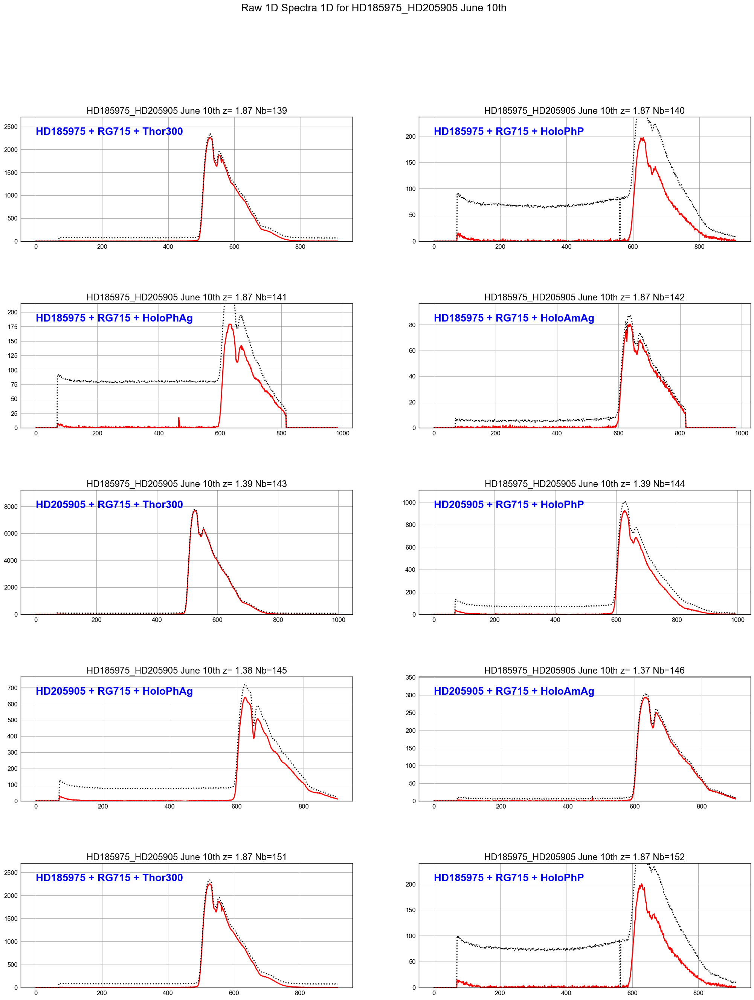

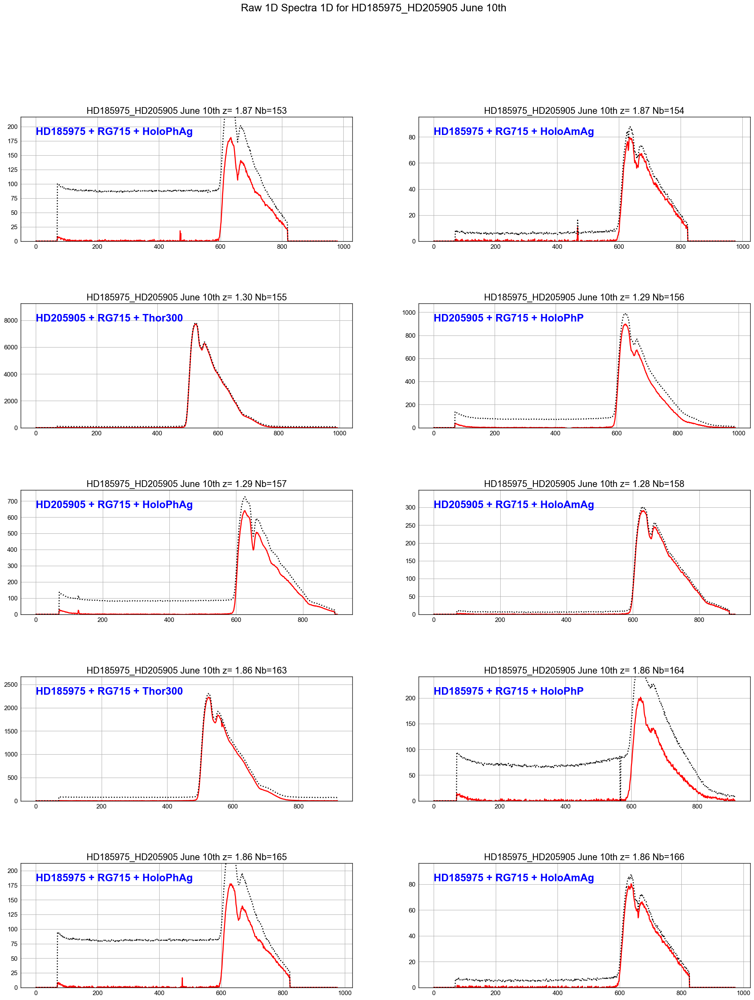

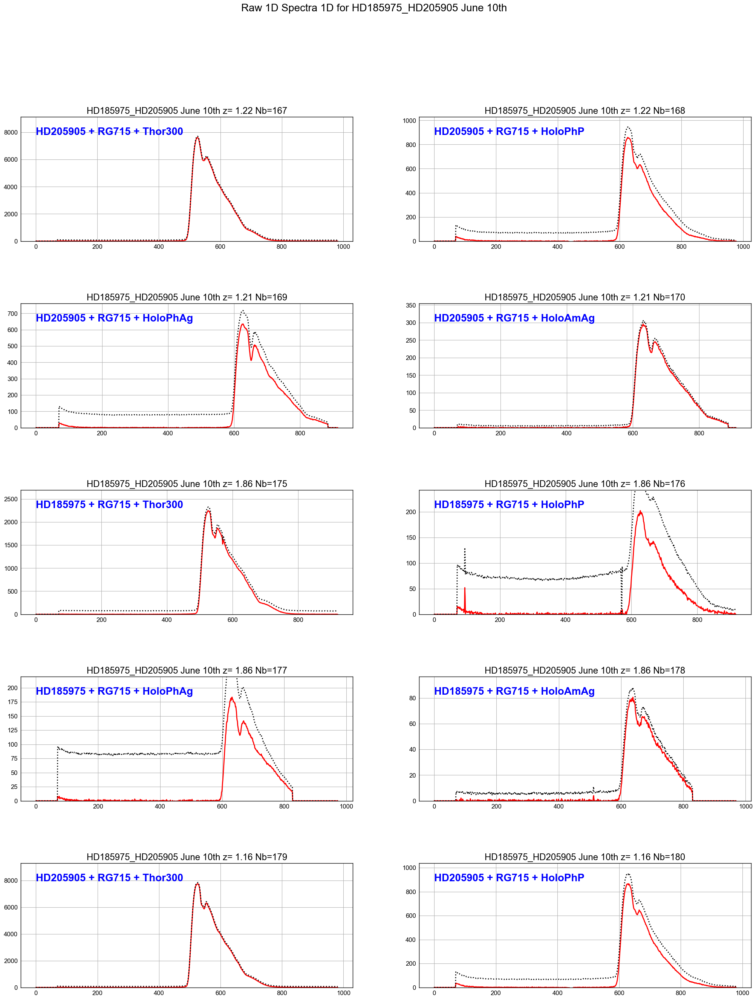

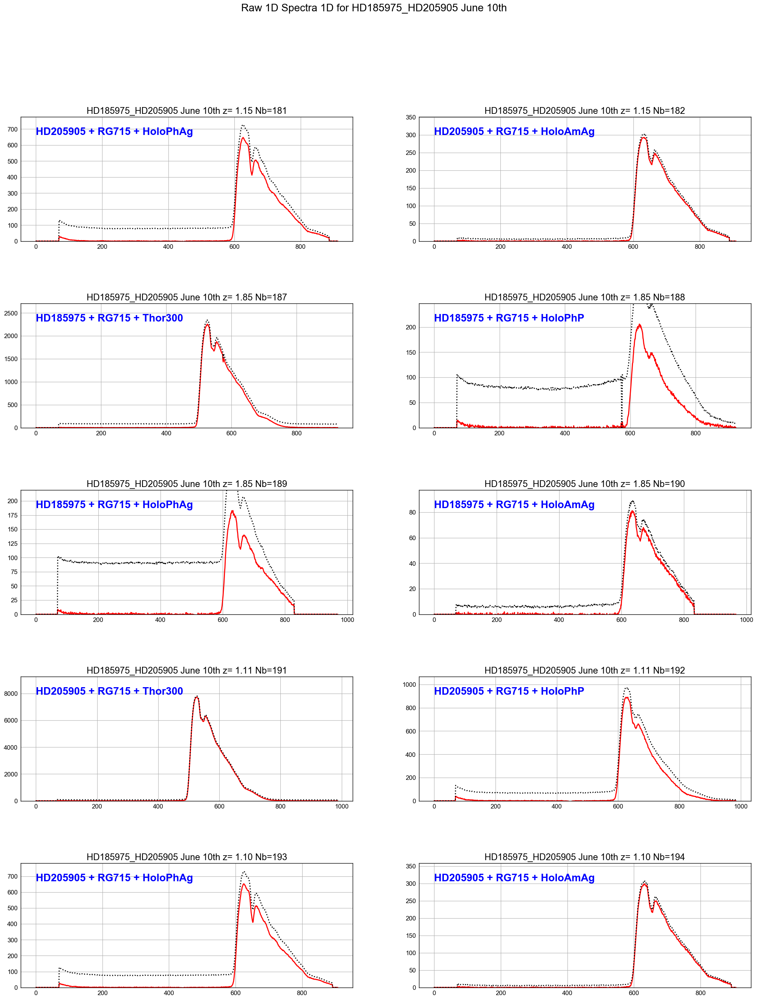

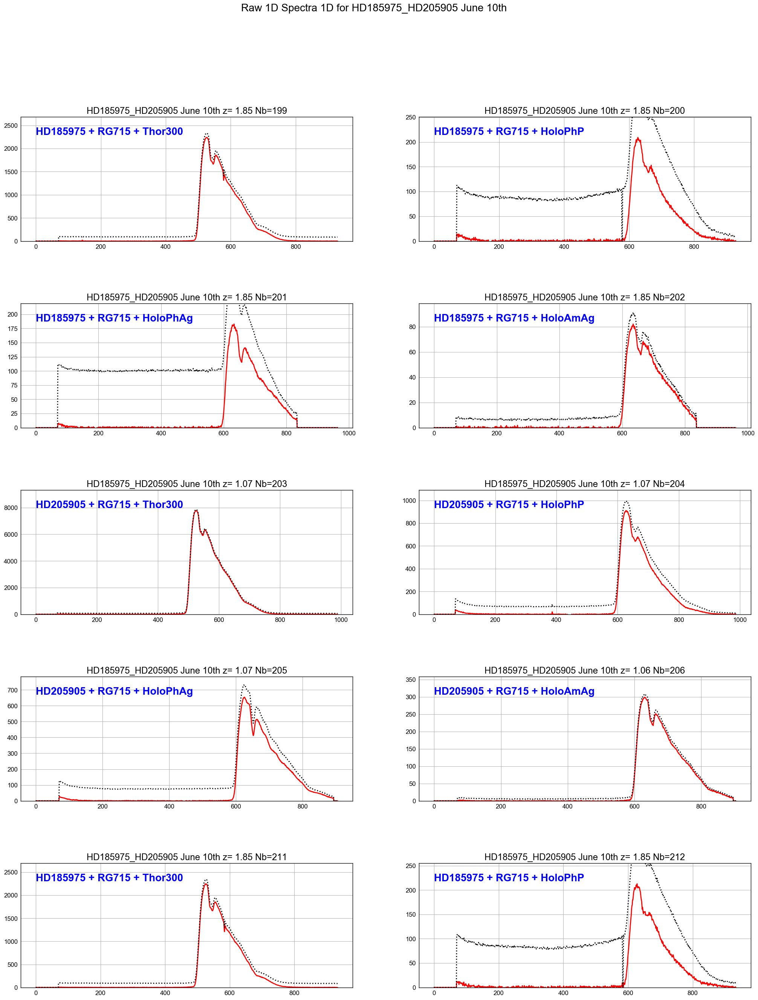

...

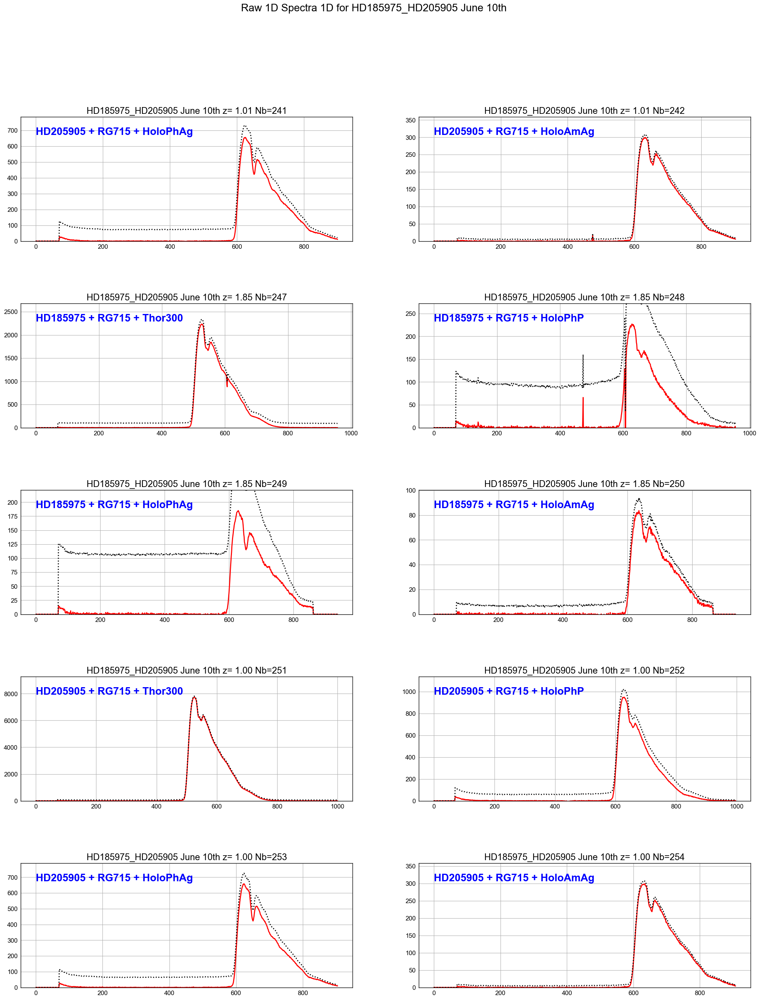

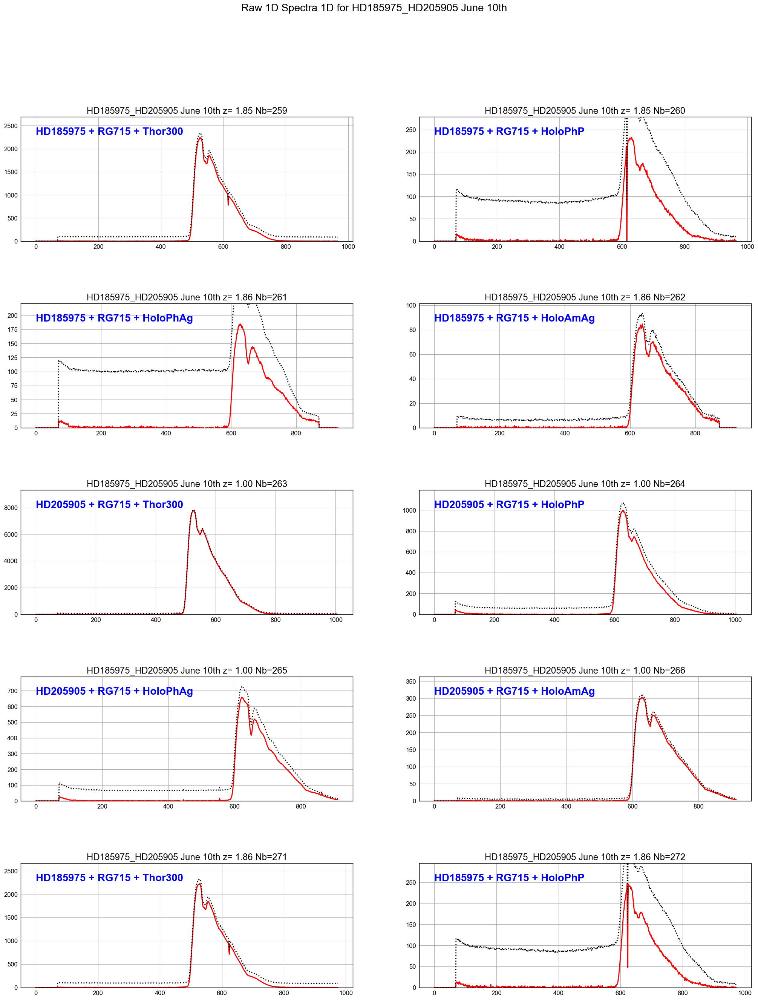

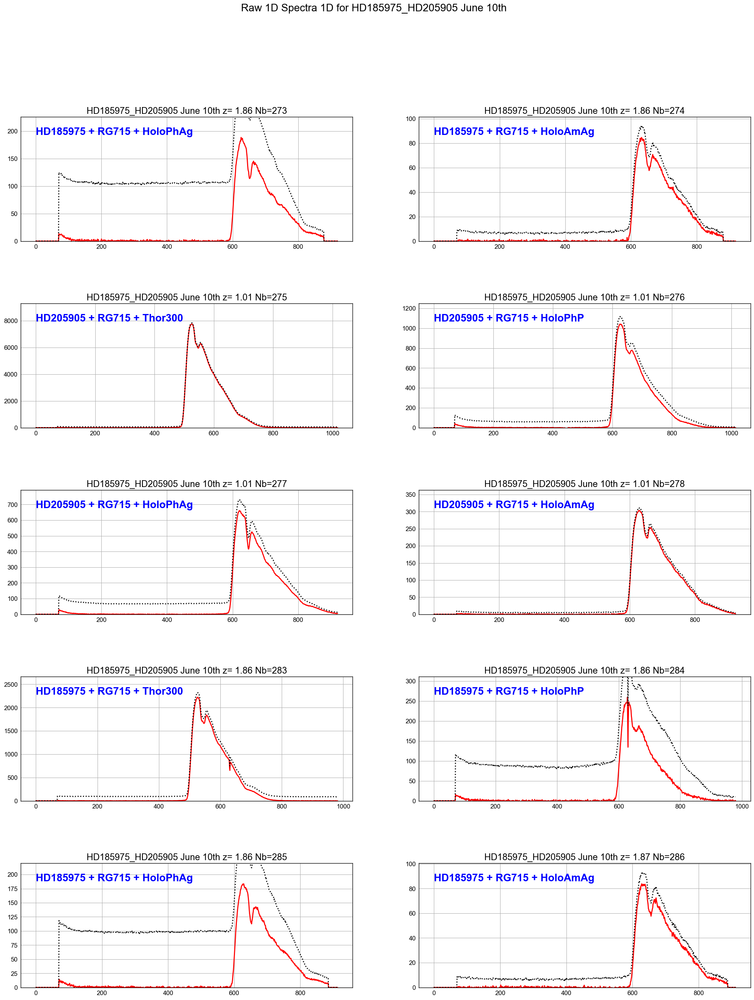

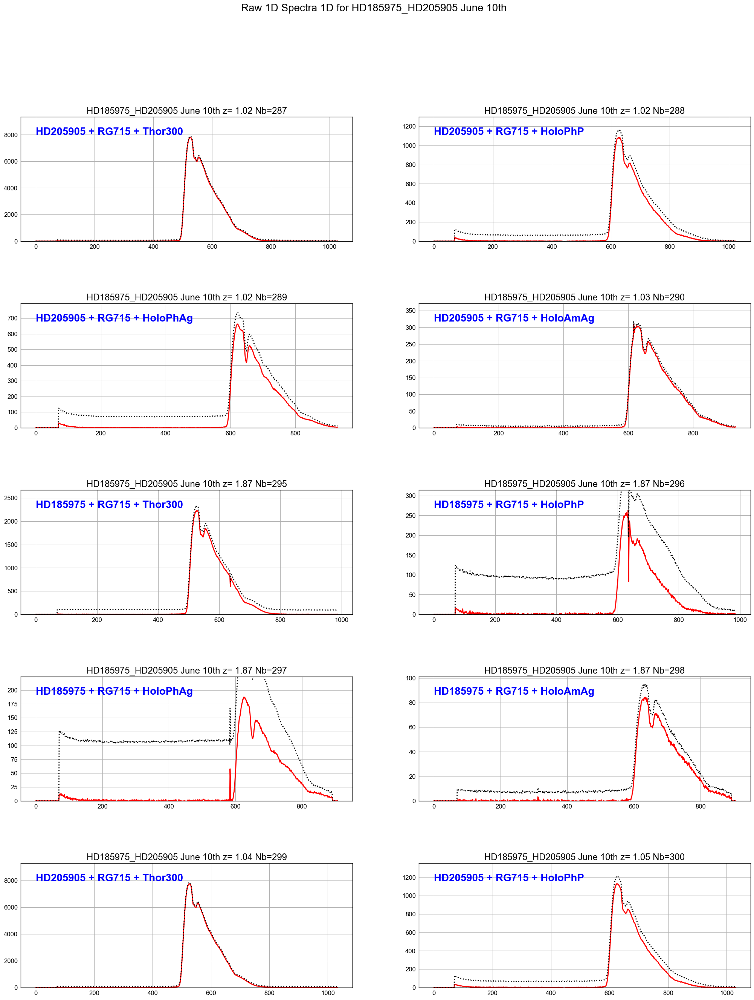

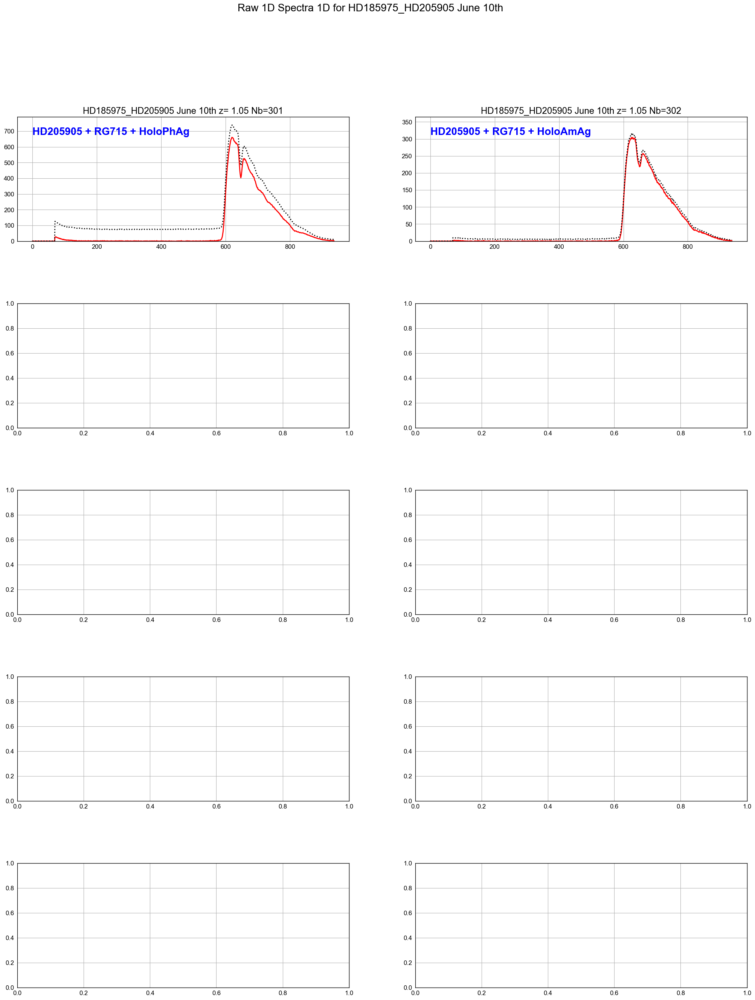

In [46]:
ShowSpectra(all_rightspectra,all_totrightspectra,all_titles,object_name,dir_top_images,all_filt,'raw1Dspectra_right.pdf')

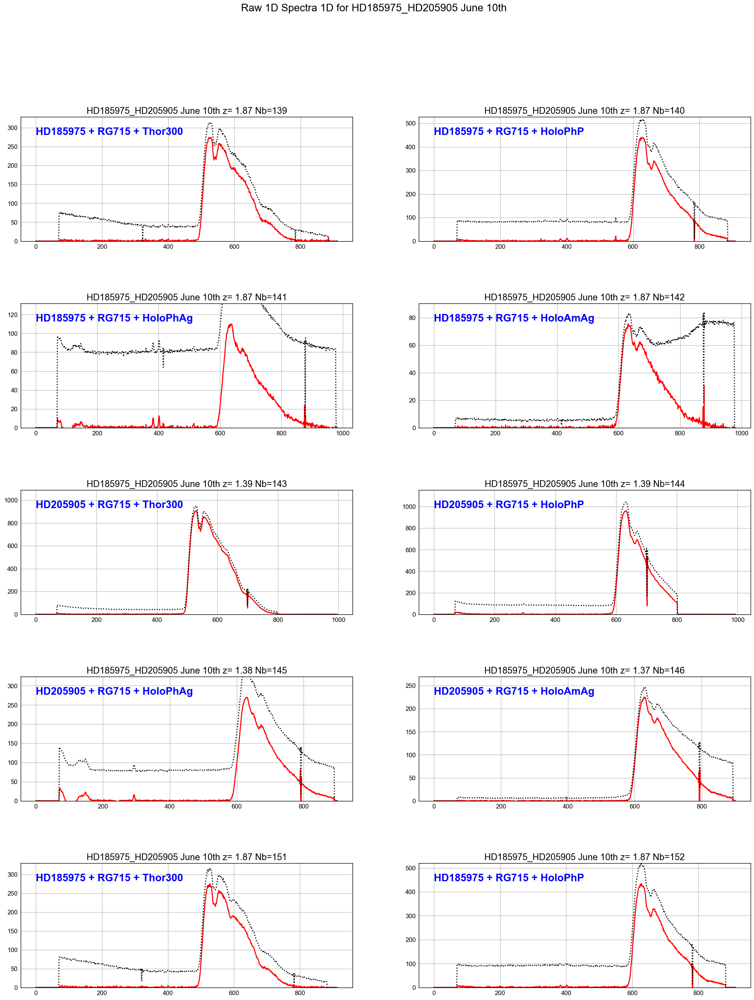

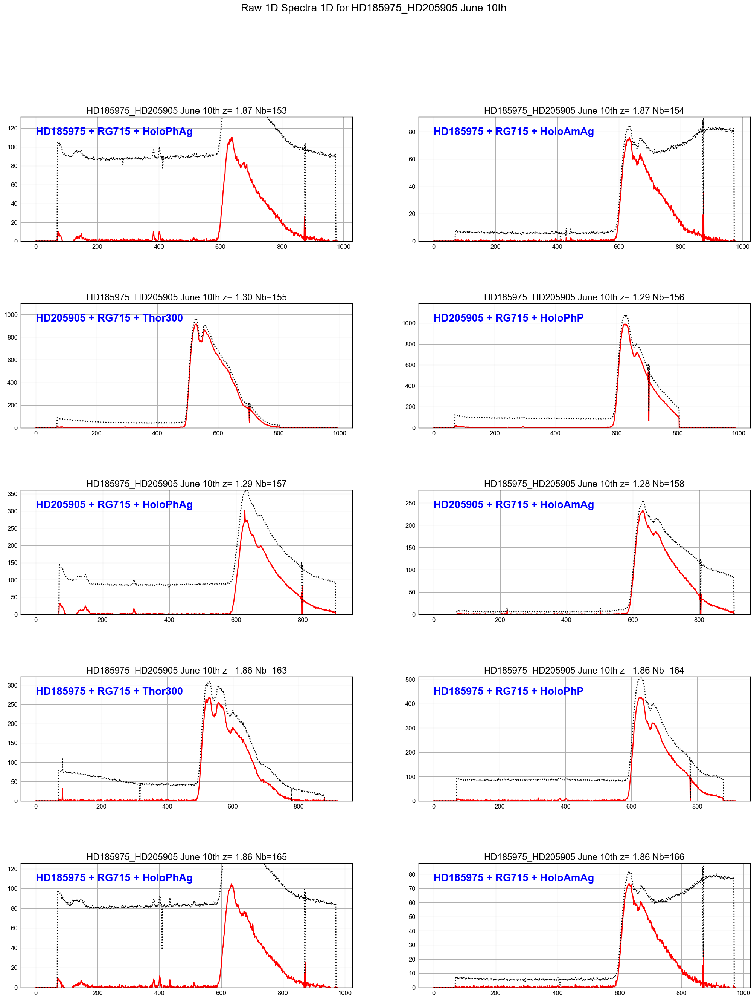

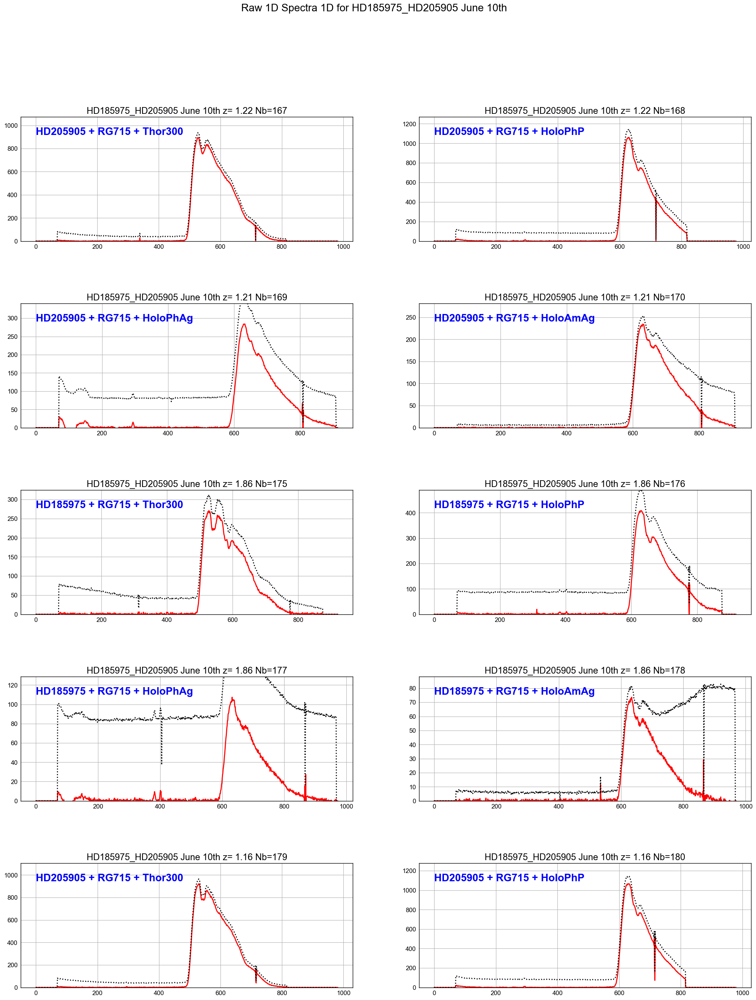

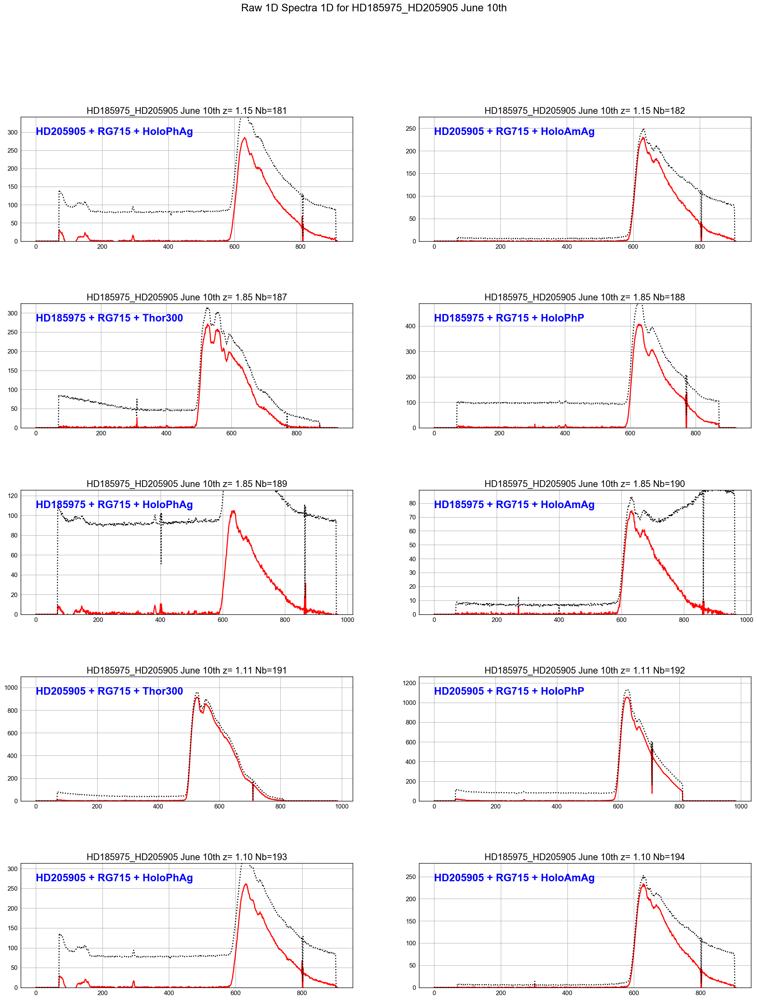

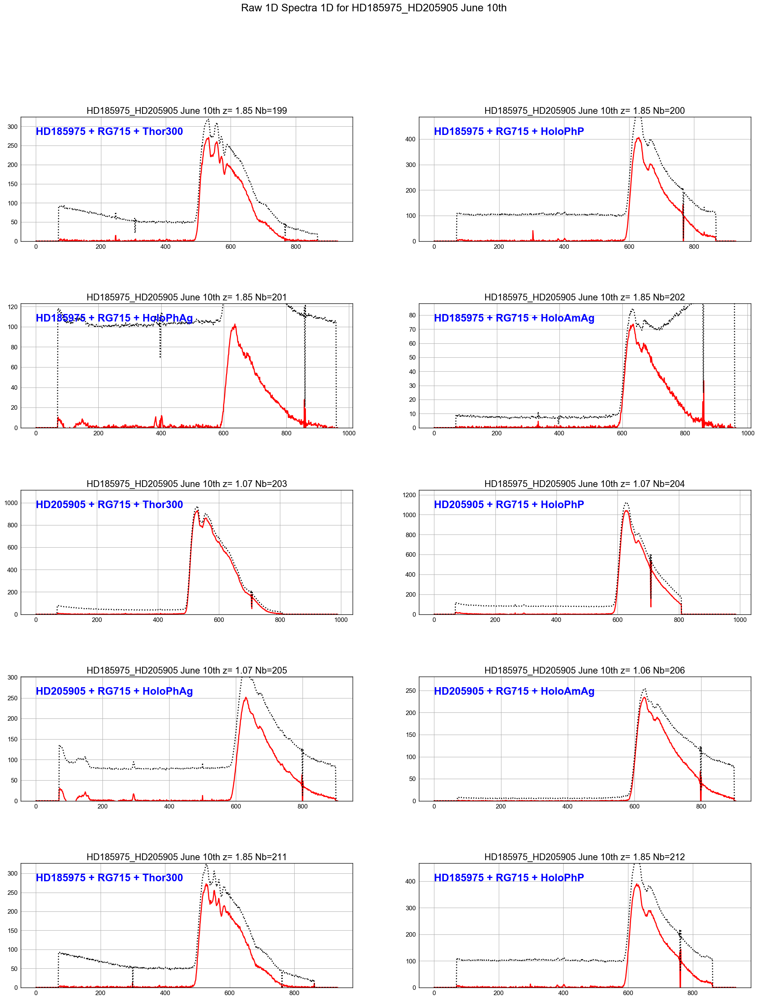

...

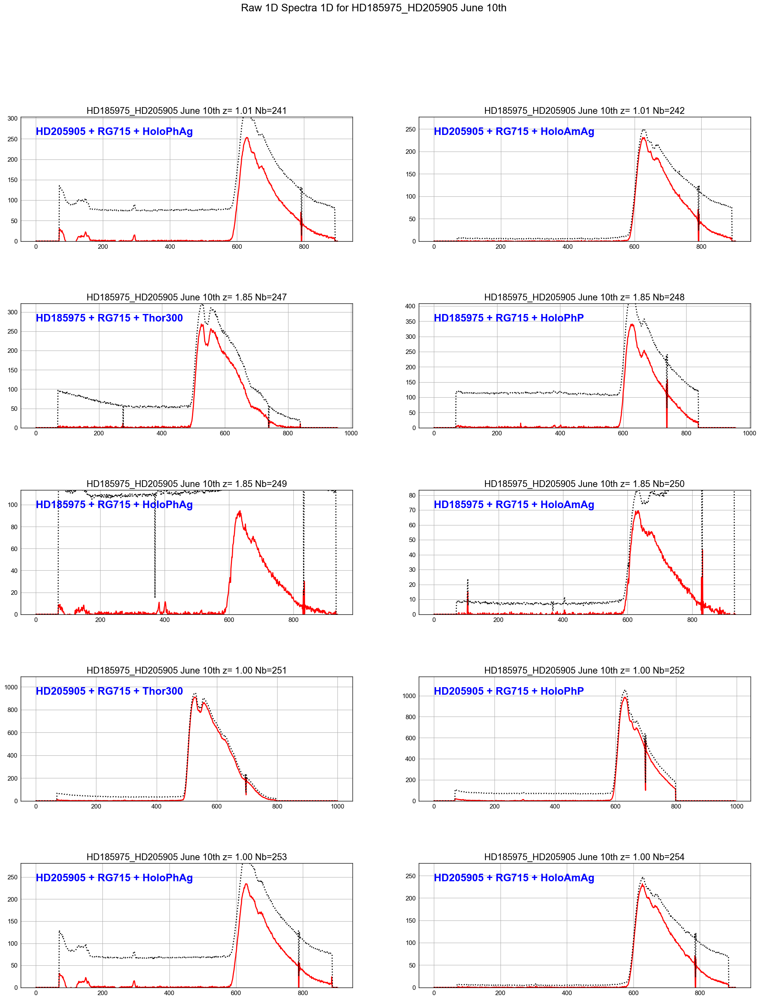

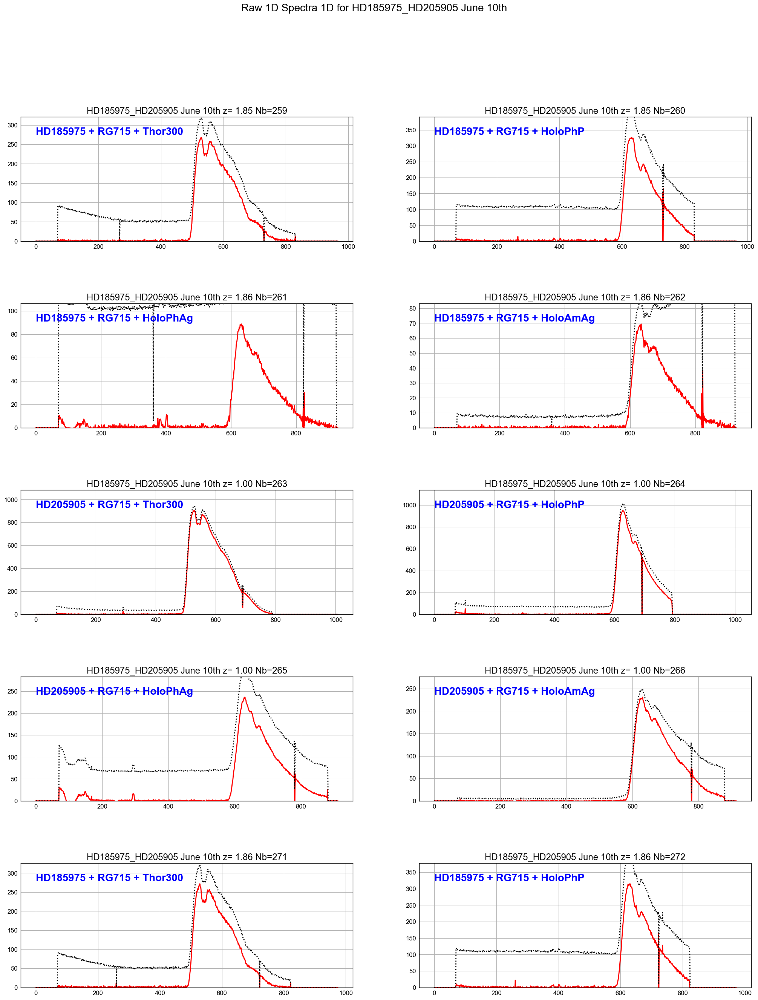

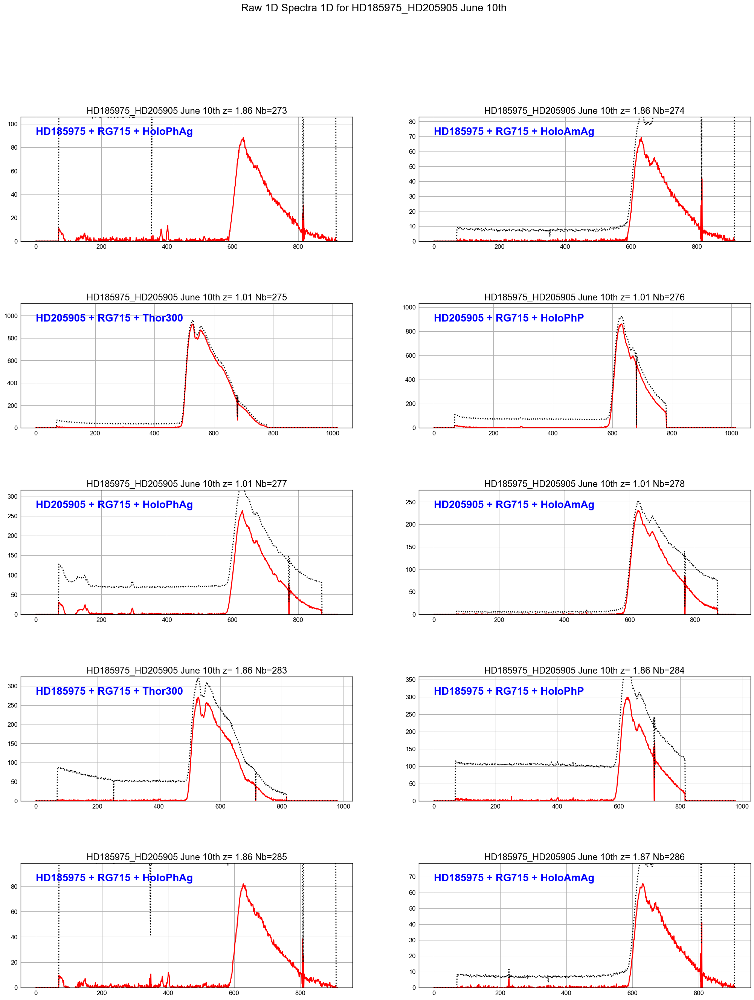

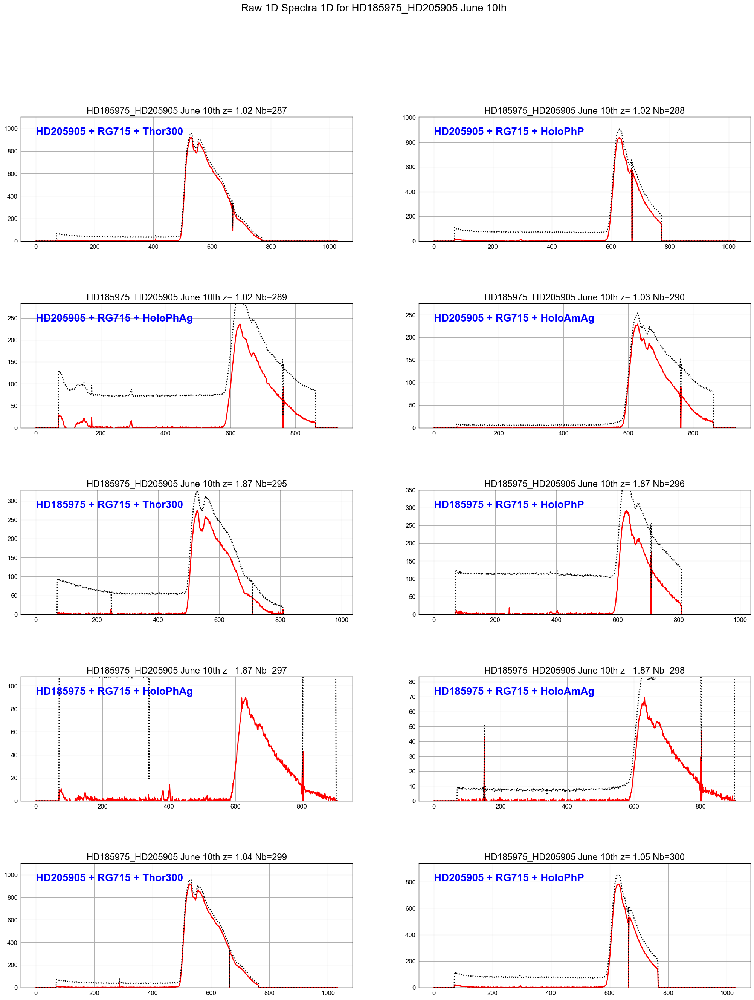

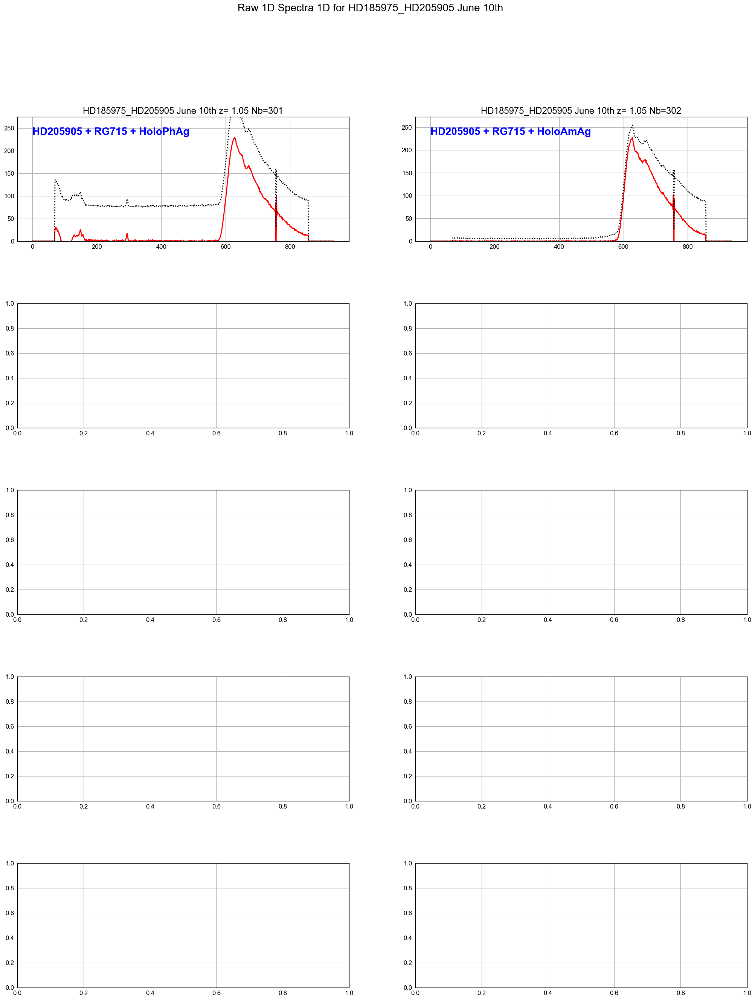

In [47]:
ShowSpectra(all_leftspectra,all_totleftspectra,all_titles,object_name,dir_top_images,all_filt,'raw1Dspectra_left.pdf')

In [48]:
sel=2

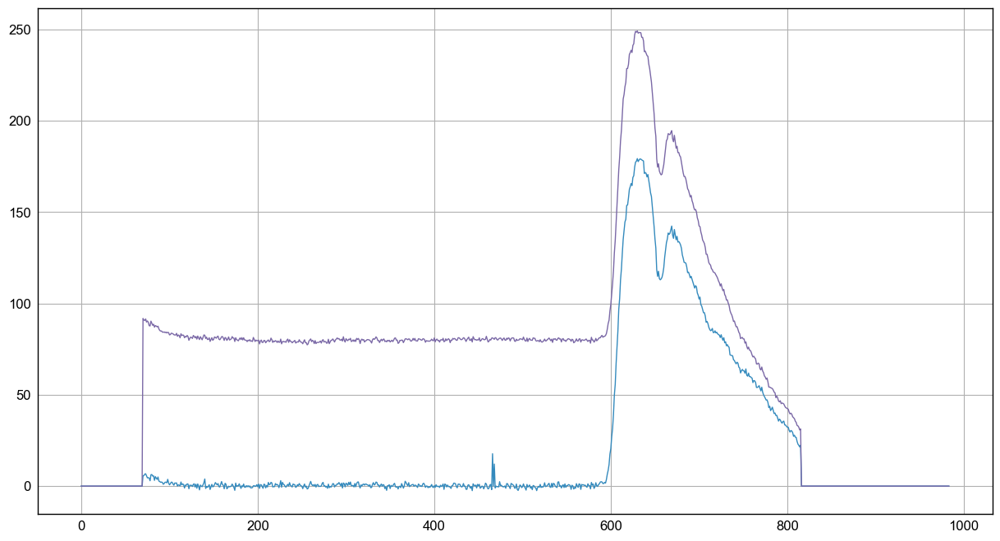

In [49]:
plt.figure(figsize=(15,8))
plt.plot(all_rightspectra[sel])
plt.plot(all_totrightspectra[sel])
#plt.xlim(0,500)
plt.grid(True)

## Calibrate in wavelength

In [50]:
from holo_specs import *

In [51]:
#%%cython
%load_ext autoreload
%autoreload 2
#import numpy as np
#import matplotlib.pyplot as plt
#import os

from holo_specs import *

def CALSPECAbsLineIdentification(spectra,redshift,all_titles,object_name,dir_top_images,all_filt,figname,tagname):
    """
    CALSPECAbsLineIdentification show the right part of spectrum with identified lines
    =====================
    """
    
    
    NBSPEC=len(spectra)
    NBIMGPERROW=2
    
    MAXIMGROW=max(2,int(m.ceil(float(NBSPEC)/float(NBIMGPERROW))))
    
    
    # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    
    figfilename=os.path.join(dir_top_images,figname)
   
    pp = PdfPages(figfilename) # create a pdf file
    
    
    title='WL calibrated 1D Spectra 1D for {} {}'.format(object_name,tagname)
    
    
    all_wl= []  # containers for wavelength
    
    ###############################
    left_cut = 0
    right_cut = 1800
    ################################
    
    
    for index in np.arange(0,NBSPEC):
        
             
        # new pdf page    
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the pdf page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        
        
        spec = spectra[index]
        ######## convert pixels to wavelengths #########
        print '-----------------------------------------------------'
        print all_filt[index]
        holo = Hologram(all_filt[index])
        print '-----------------------------------------------------'
        #pixels = np.arange(left_cut,right_cut,1)
        pixels = np.arange(left_cut,left_cut+spec.shape[0],1)
        lambdas = holo.grating_pixel_to_lambda(pixels)
        
        # bidouillage loca1
        if(all_filt[index]=='Ron200'):
            print 'bidouille speciale Ron200 à la main'
            lambdas*=3.5/2.0
        all_wl.append(lambdas)
        
        axarr[iy,ix].plot(lambdas,spec,'r-',lw=2,label=tagname)
    
        ######## plot QSO emission lines ############
        axarr[iy,ix].plot([HALPHA*(1+redshift),HALPHA*(1+redshift)],[0.,spec.max()*1.2],lw=2,label='$H\\alpha$')
        axarr[iy,ix].plot([HBETA*(1+redshift),HBETA*(1+redshift)],[0.,spec.max()*1.2],lw=2,label='$H\\beta$')
        axarr[iy,ix].plot([HGAMMA*(1+redshift),HGAMMA*(1+redshift)],[0.,spec.max()*1.2],lw=2,label='$H\\gamma$')
        axarr[iy,ix].plot([HDELTA*(1+redshift),HDELTA*(1+redshift)],[0.,spec.max()*1.2],lw=2,label='$H\\delta$')
        
        axarr[iy,ix].plot([760,760],[0.,spec.max()*1.2],lw=2,label='$O_2$')
        
        
        #plot_atomic_lines(axarr[index],spec.max()*1.2,redshift=redshift,atmospheric_lines=False)
        ######## set plot
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].text(600.,spec.max()*1.1, all_filt[index],verticalalignment='top', horizontalalignment='left',color='blue',fontweight='bold', fontsize=20)
        axarr[iy,ix].legend(loc='best',fontsize=16)
        axarr[iy,ix].set_xlabel('Wavelength [nm]', fontsize=16)
        axarr[iy,ix].grid(True)
        axarr[iy,ix].set_ylim(0.,spec.max()*1.2)
        axarr[iy,ix].set_xlim(np.min(lambdas),np.max(lambdas))
    
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
    
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()   
   
    return all_wl


In [52]:
redshift=0

-----------------------------------------------------
Thor300
Grating plate center at x0 = 1024.0 and y0 = 1024.0 with average tilt of -0.6 degrees
N = 299.43 +/- 0.88 grooves/mm
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Order  0 position at x0 = 1132.4 and y0 = 1266.7
Order +1 position at x0 = 1663.6 and y0 = 1261.3
Distance between the orders: 531.21 pixels (12.75 mm)
-----------------------------------------------------
-----------------------------------------------------
HoloPhP
Grating plate center at x0 = 1024.0 and y0 = 1024.0 with average tilt of -1.0 degrees
N = 355.08 +/- 1.03 grooves/mm
Hologram center at x0 = 843.0 and y0 = 629.0 with average tilt of -1.0 degrees
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -1.0 degrees
Order  0 position at x0 = 577.4 and y0 = 633.7
Order +1 position at x0 = 1108.6 and y0 = 624.3
Distance between the orders: 

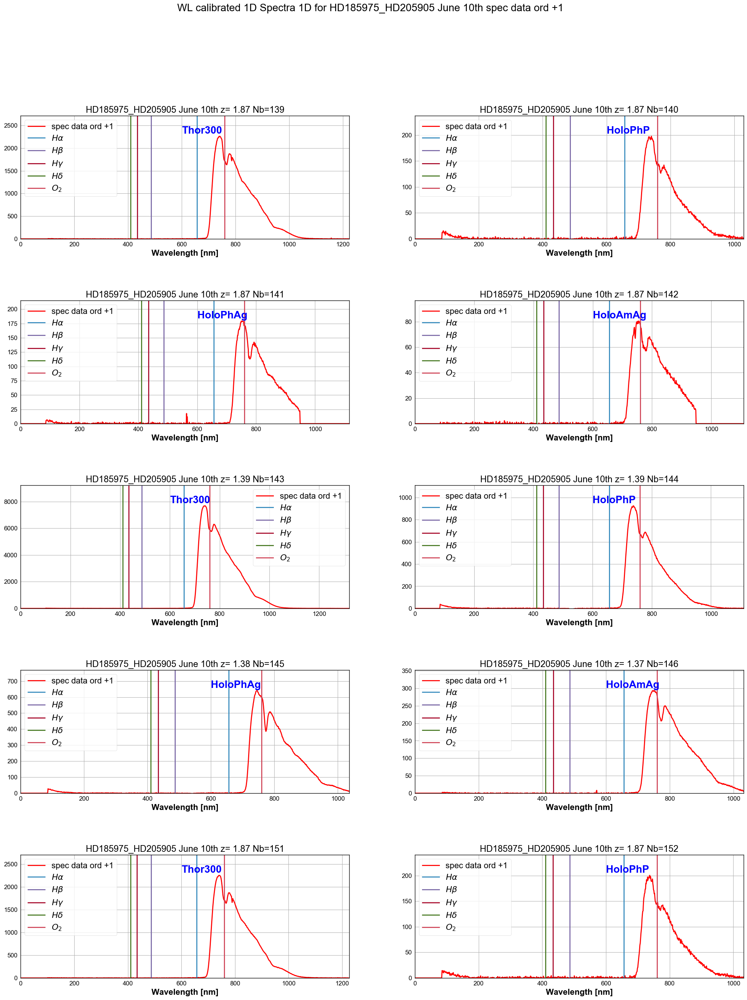

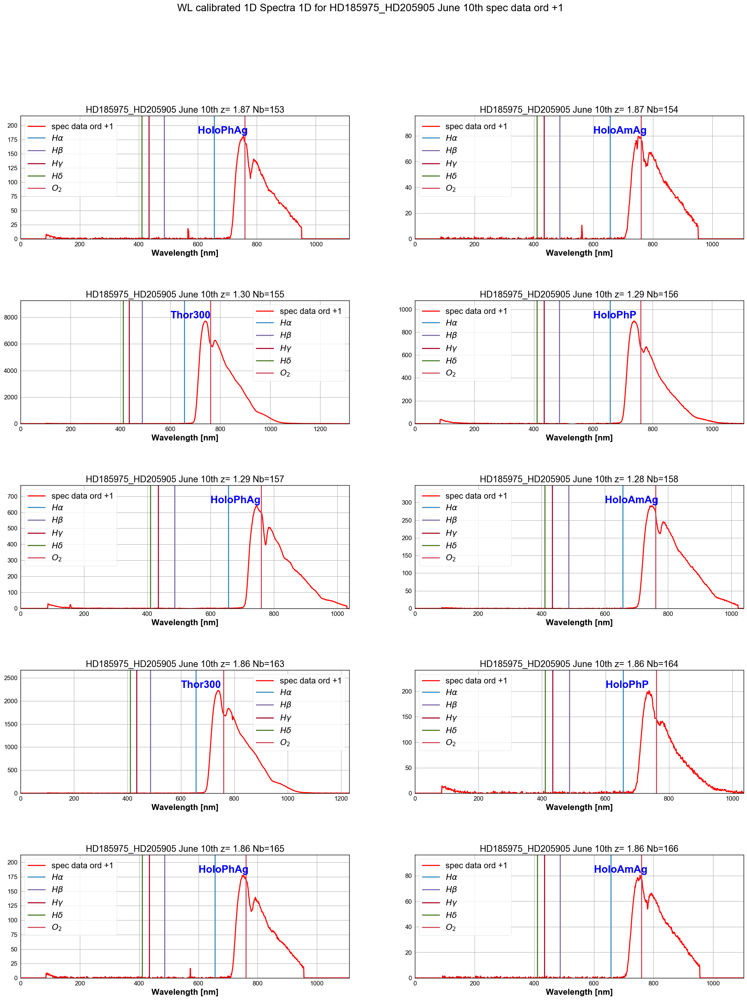

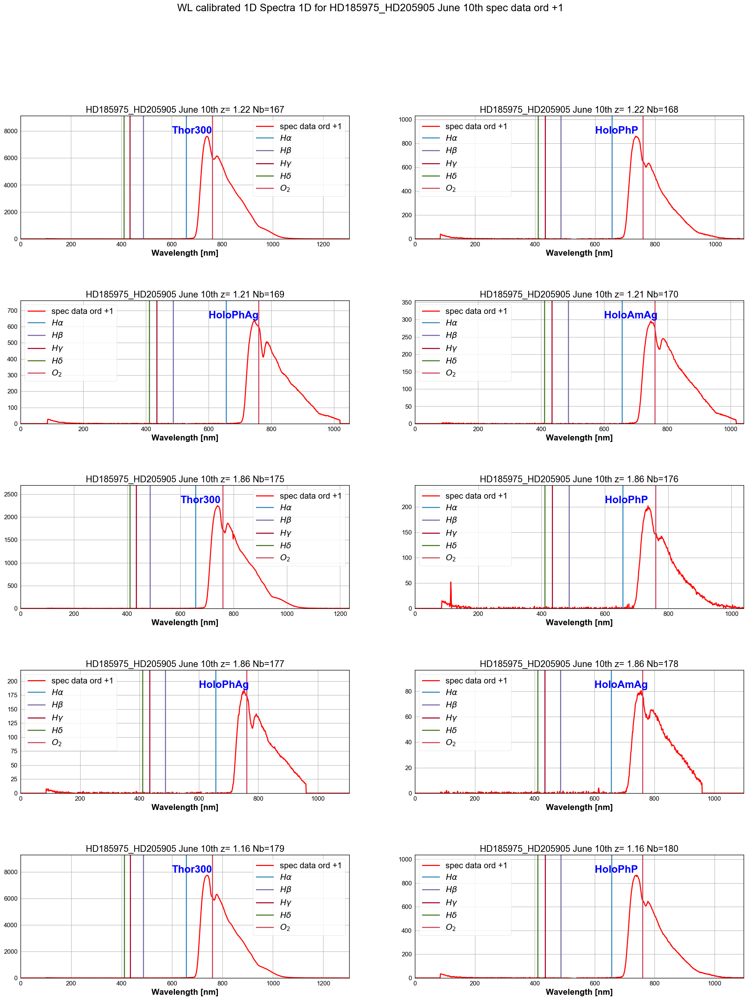

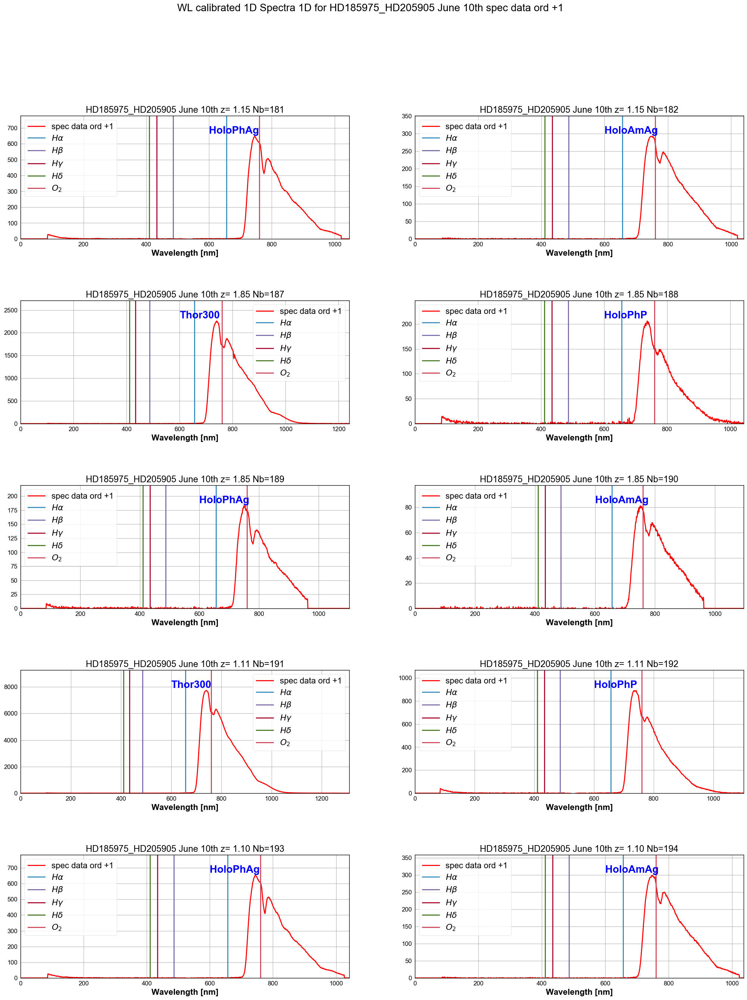

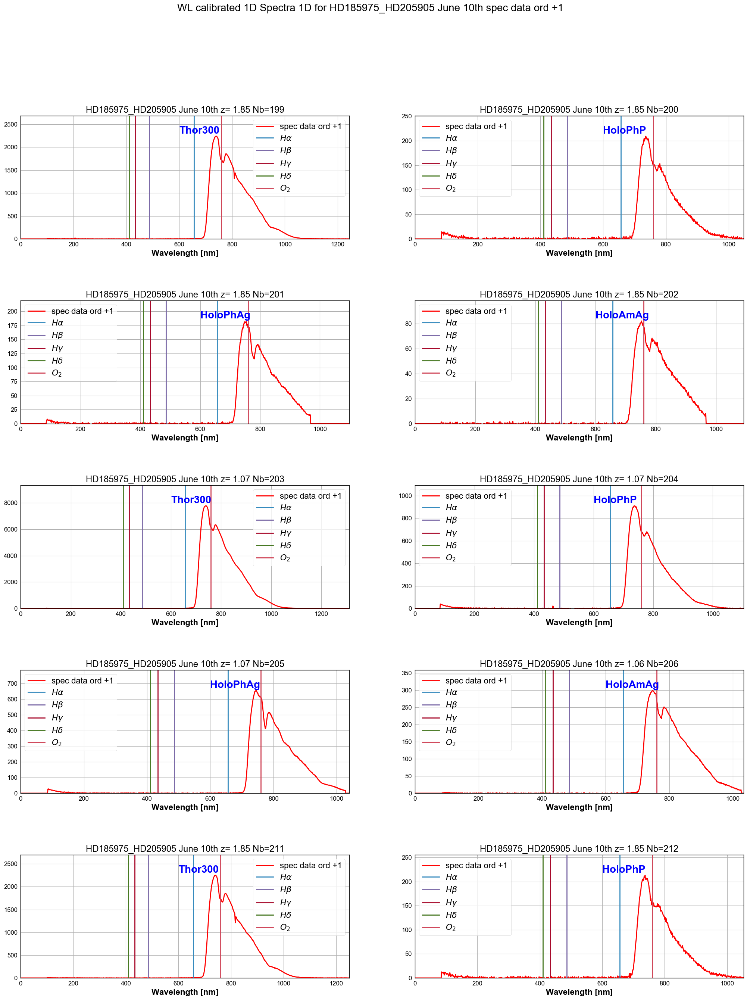

...

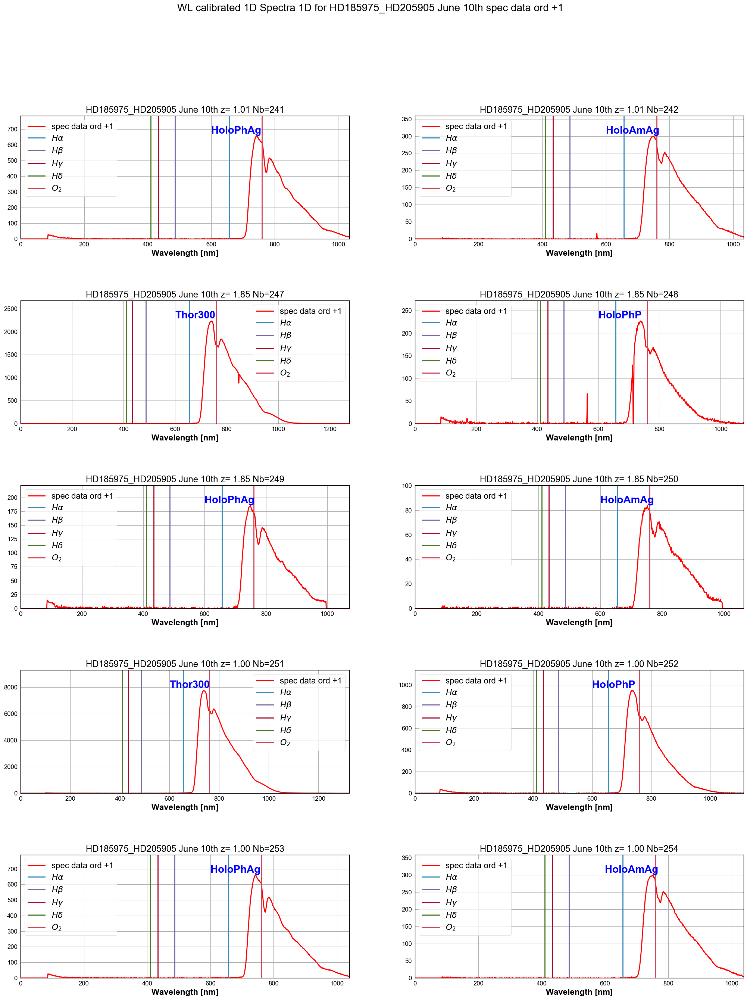

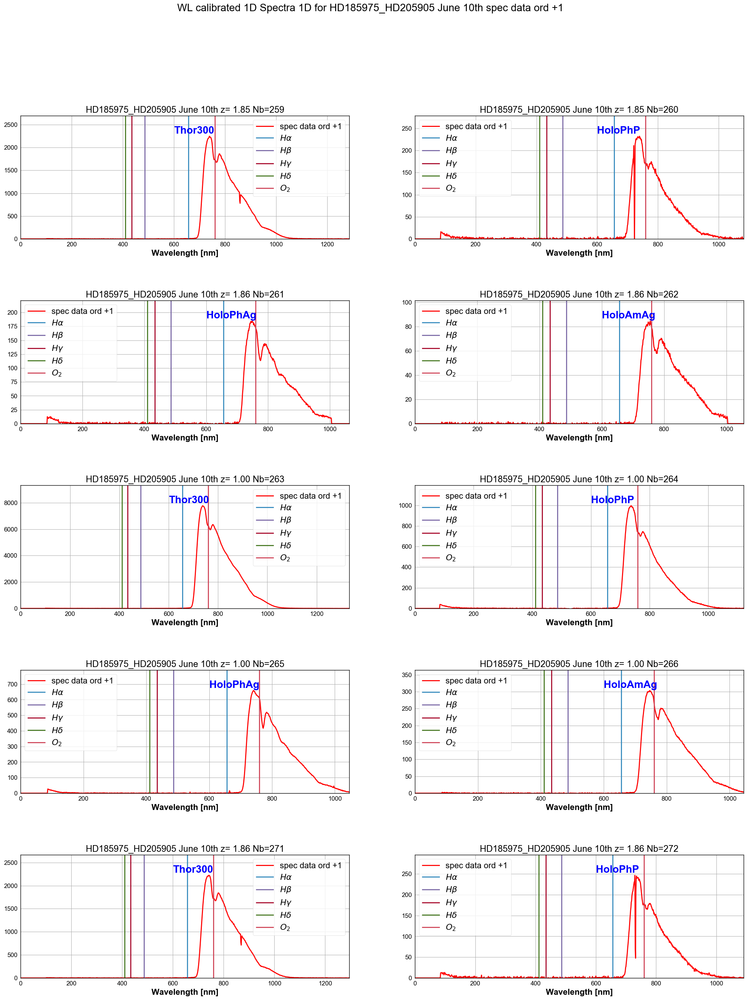

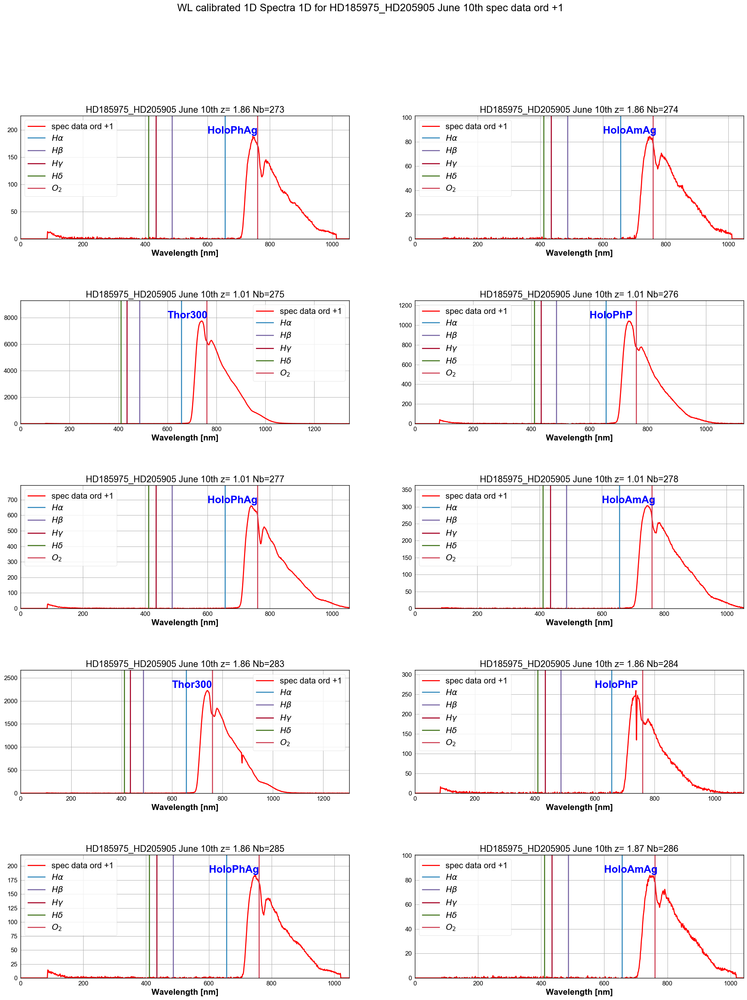

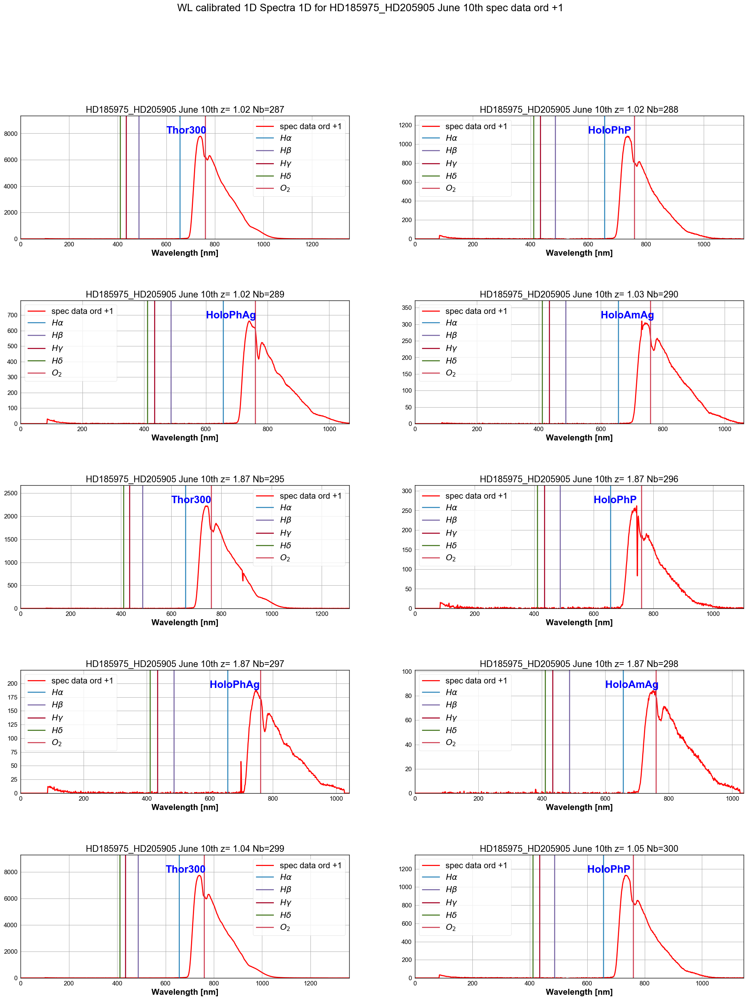

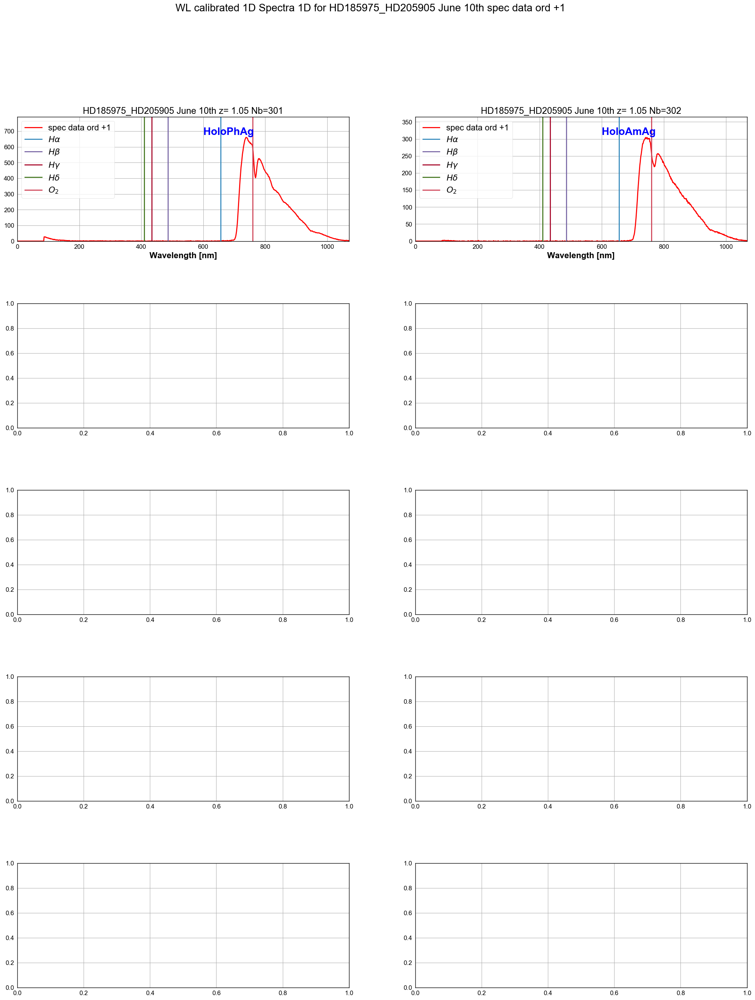

In [53]:
all_wl_right=CALSPECAbsLineIdentification(all_rightspectra,redshift,all_titles,object_name,dir_top_images,all_filt2,'CALSPEC_rightspectrum.pdf','spec data ord +1')

-----------------------------------------------------
Thor300
Grating plate center at x0 = 1024.0 and y0 = 1024.0 with average tilt of -0.6 degrees
N = 299.43 +/- 0.88 grooves/mm
Hologram center at x0 = 1398.0 and y0 = 1264.0 with average tilt of -0.6 degrees
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -0.6 degrees
Order  0 position at x0 = 1132.4 and y0 = 1266.7
Order +1 position at x0 = 1663.6 and y0 = 1261.3
Distance between the orders: 531.21 pixels (12.75 mm)
-----------------------------------------------------
-----------------------------------------------------
HoloPhP
Grating plate center at x0 = 1024.0 and y0 = 1024.0 with average tilt of -1.0 degrees
N = 355.08 +/- 1.03 grooves/mm
Hologram center at x0 = 843.0 and y0 = 629.0 with average tilt of -1.0 degrees
Plate center at x0 = 774.0 and y0 = 690.7 with average tilt of -1.0 degrees
Order  0 position at x0 = 577.4 and y0 = 633.7
Order +1 position at x0 = 1108.6 and y0 = 624.3
Distance between the orders: 

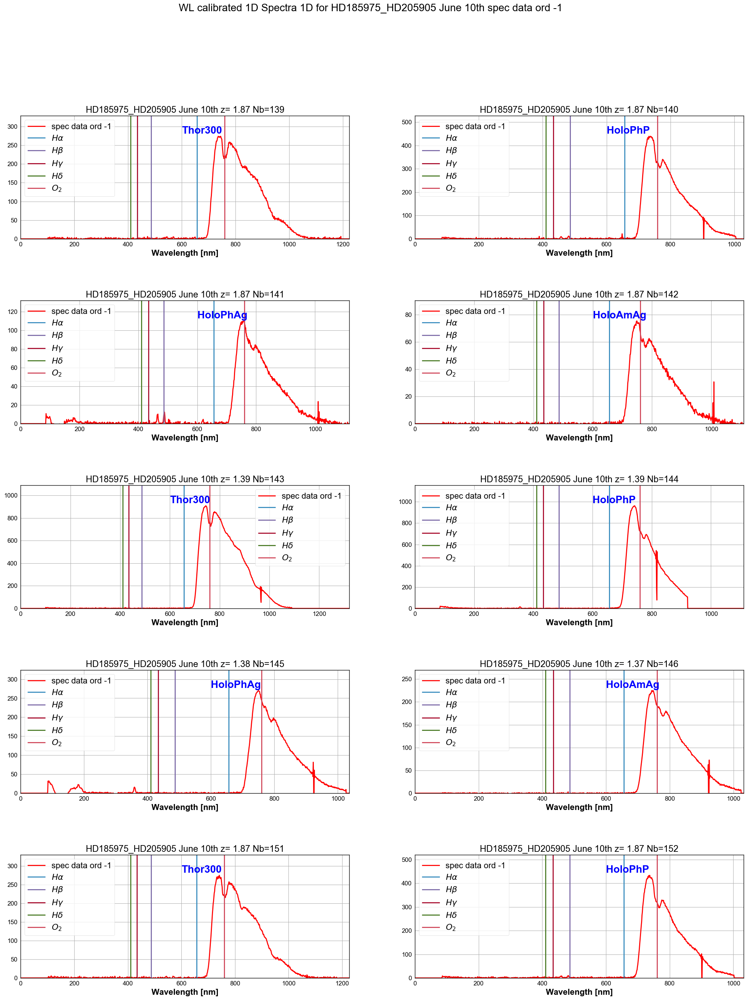

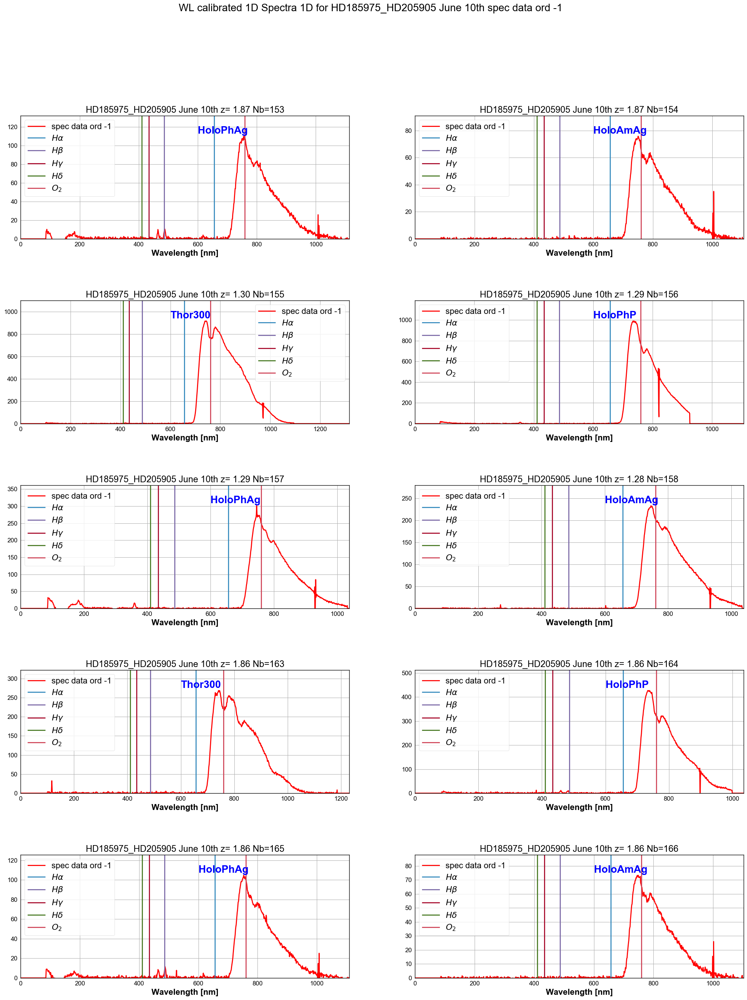

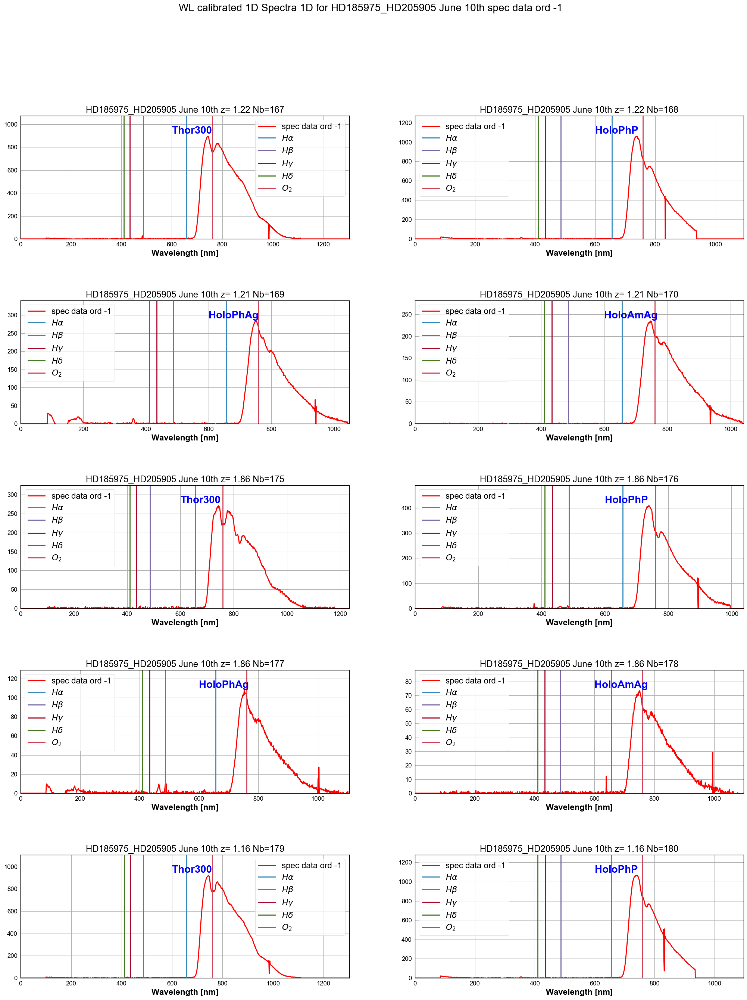

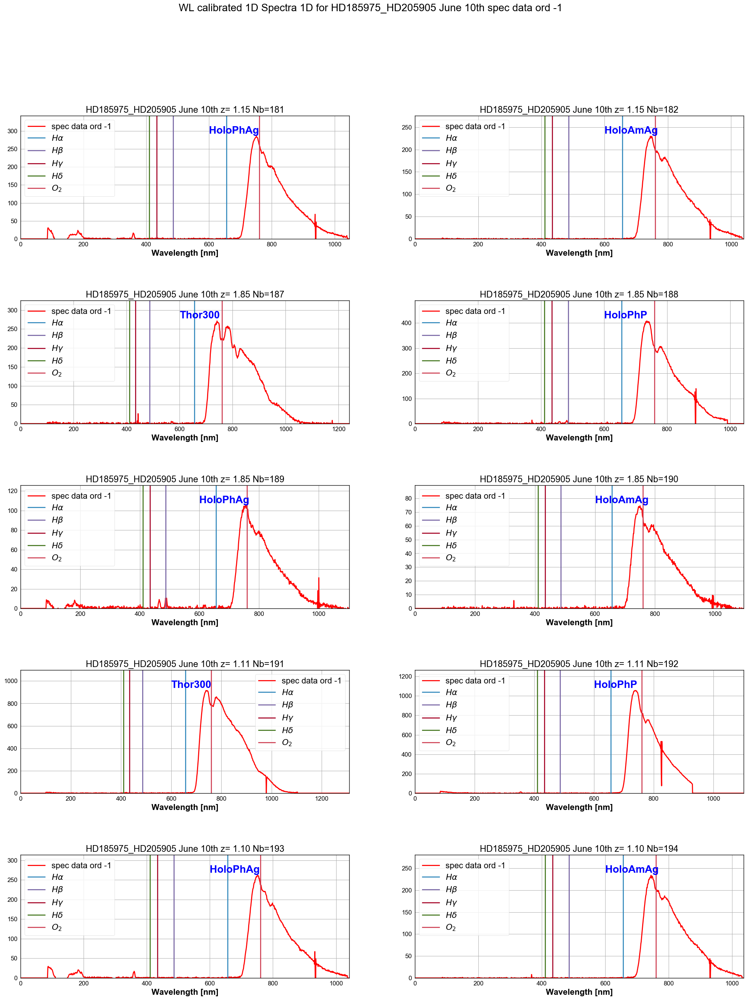

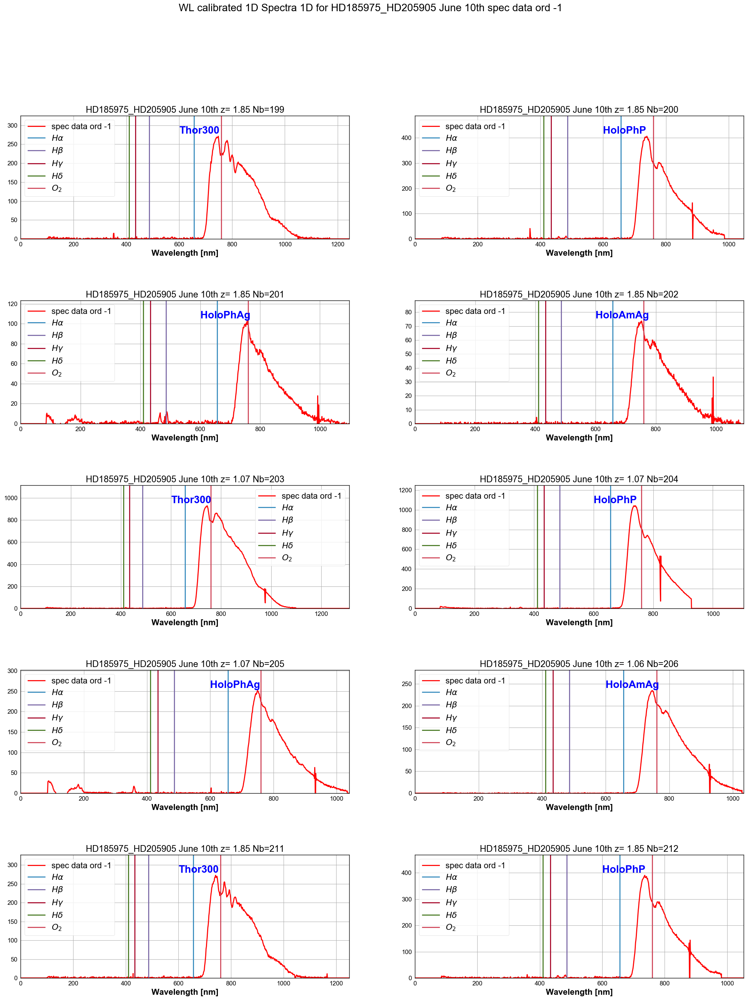

...

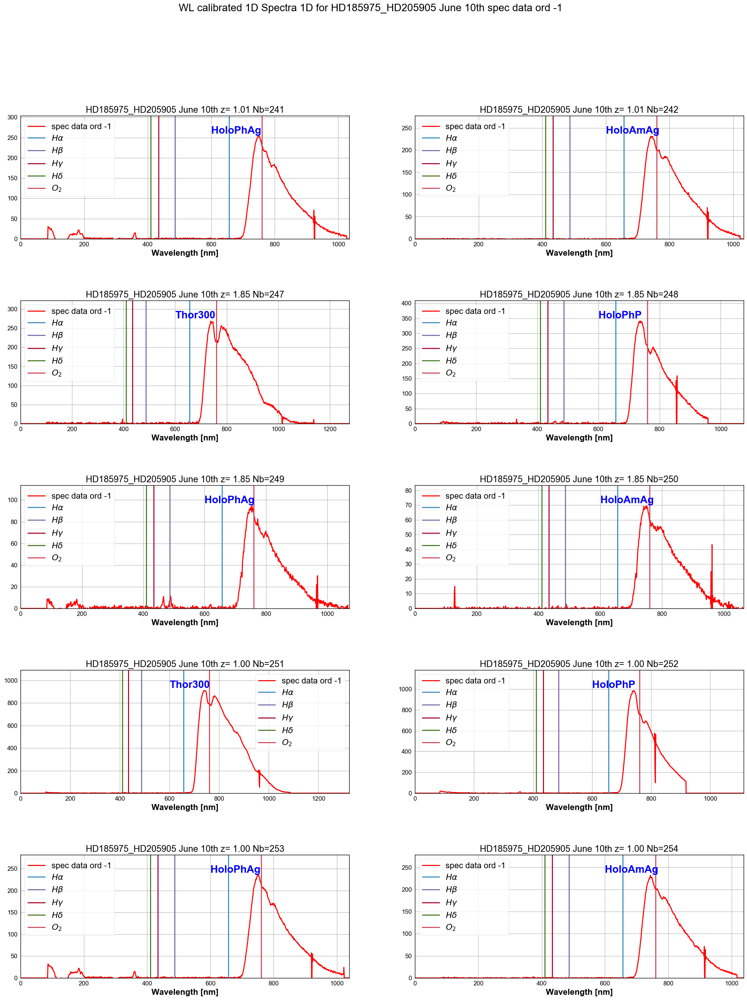

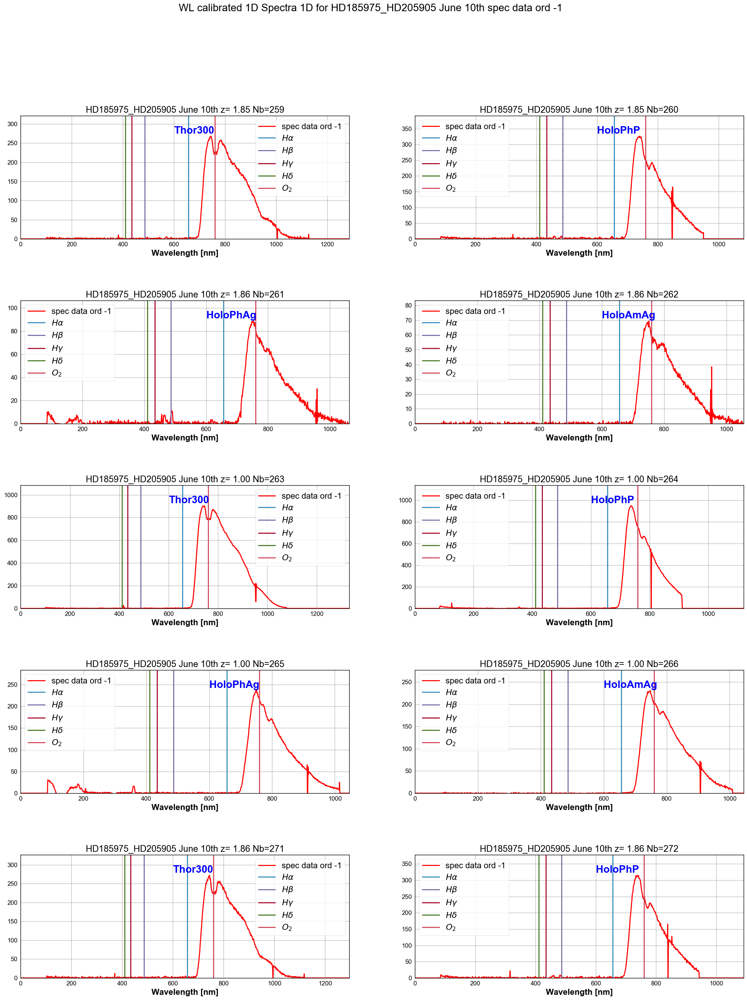

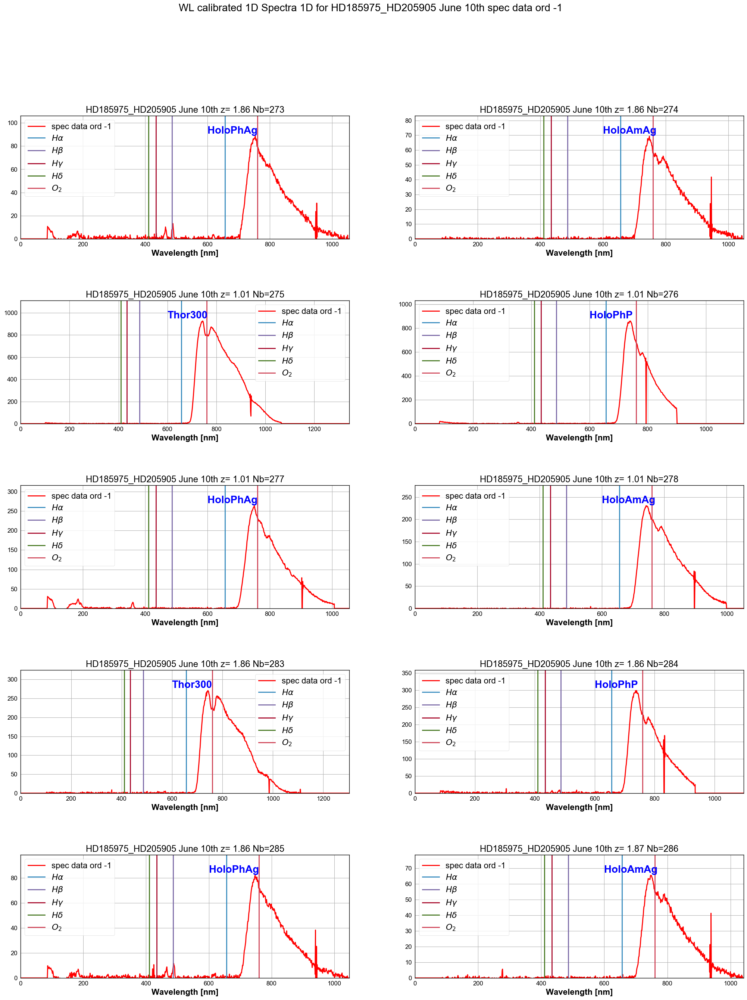

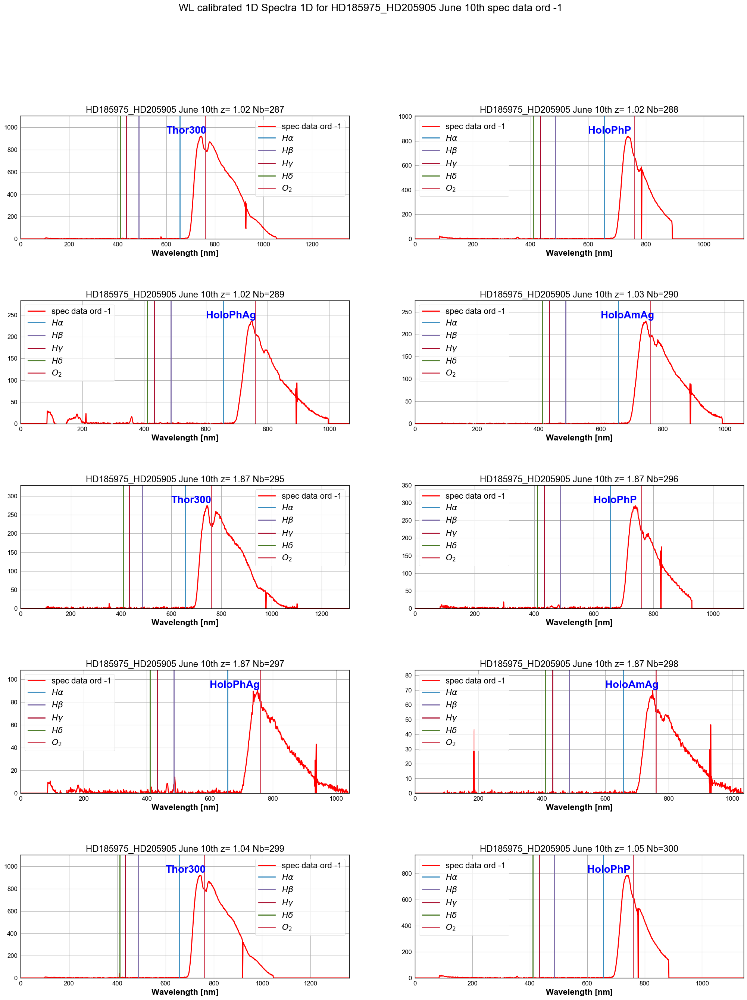

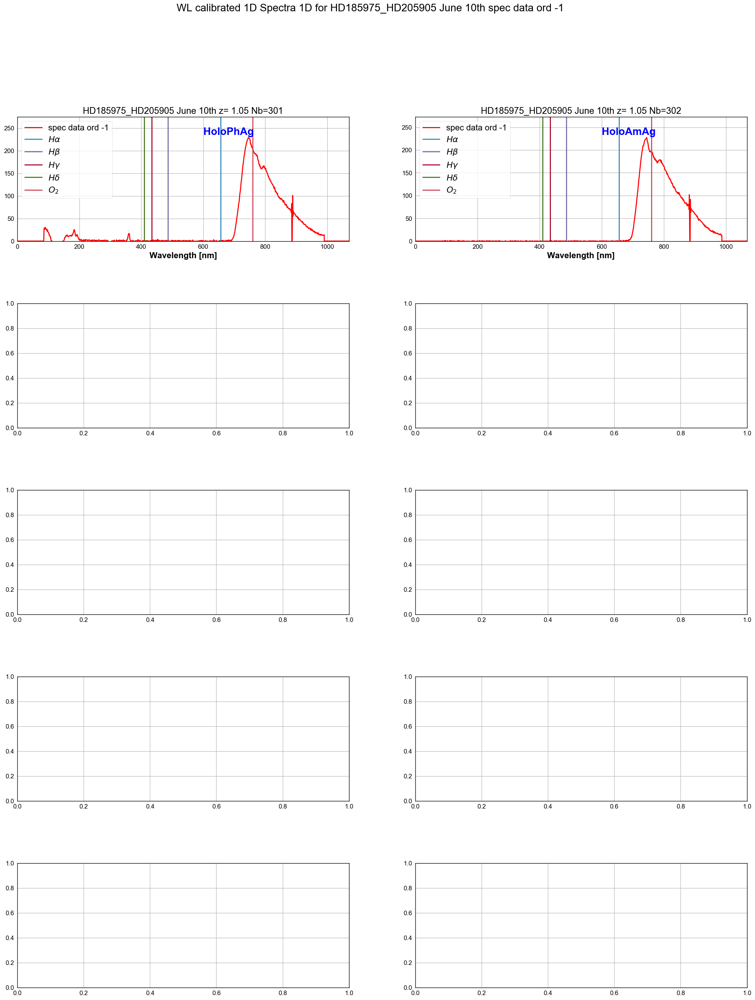

In [54]:
all_wl_left=CALSPECAbsLineIdentification(all_leftspectra,redshift,all_titles,object_name,dir_top_images,all_filt2,'CALSPEC_leftspectrum.pdf','spec data ord -1')

## Correct the spectrum

- a shift must be applied here

In [55]:
for index in HoloPhAg_index:
    all_wl_right[index]-=10.0
    all_wl_left[index]+=10.0

In [56]:
for index in HoloAmAg_index:
    all_wl_right[index]-=10.0
    all_wl_left[index]+=10.0

## Compare spectra

In [57]:
def CompareSpectrumProfile(wl,spectra,all_titles,object_name,all_filt,dir_top_img,grating_name):
    """
    CompareSpectrumProfile
    =====================
    
    """
    shortfilename='CompareSpec_'+grating_name+'.pdf'
    title="Compare spectra of {} with disperser {}".format(object_name,grating_name)
    figfilename=os.path.join(dir_top_img,shortfilename)
    pp = PdfPages(figfilename) # create a pdf file
    
    
    f, axarr = plt.subplots(1,1,figsize=(25,15))
    f.suptitle(title,fontsize=30,fontweight='bold')
    
    NBSPEC=len(spectra)
    
    min_z=min(all_airmass)
    max_z=max(all_airmass)
    
    maxim_y_to_plot= []

    texte='airmass : {} - {} '.format(min_z,max_z)
    
    for index in np.arange(0,NBSPEC):
                
        if re.search(grating_name,all_filt[index]):
            axarr.plot(wl[index],spectra[index],'-',lw=3)
            maxim_y_to_plot.append(spectra[index].max())
    
    max_y_to_plot=max(maxim_y_to_plot)
    axarr.set_ylim(0,max_y_to_plot)
    axarr.text(0.,max_y_to_plot*0.9, texte ,verticalalignment='top', horizontalalignment='left',color='blue',fontweight='bold', fontsize=20)
    axarr.grid(True)
    
    axarr.get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    axarr.get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
    axarr.grid(b=True, which='major', color='k', linewidth=2.0)
    axarr.grid(b=True, which='minor', color='grey', linewidth=0.5)

    
    
    axarr.set_xlabel("wavelength (nm)",fontsize=25,fontweight='bold')
    
        
    f.savefig(pp, format='pdf')
    f.show()
    
    pp.close()     
    

In [58]:
ListOfDisperserNames=['Thor300', 'HoloPhP', 'HoloPhAg', 'HoloAmAg']

In [59]:
import matplotlib 
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 

In [60]:
#for dispname in ListOfDisperserNames:
#    CompareSpectrumProfile(all_wl_right,all_rightspectra,all_titles,object_name,all_filt,dir_top_images,dispname)

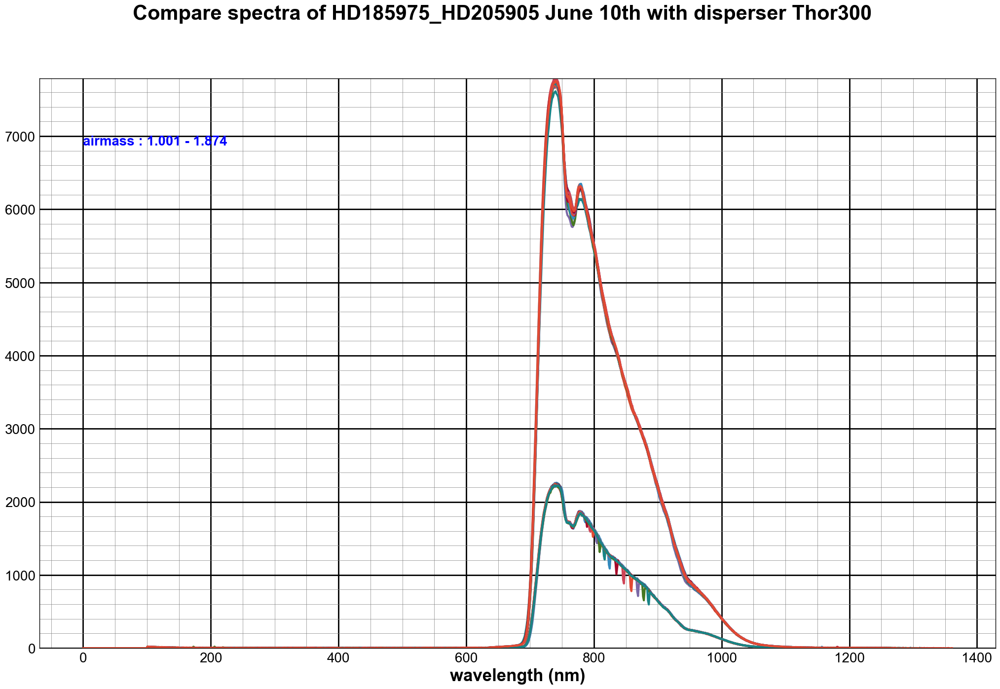

In [61]:
CompareSpectrumProfile(all_wl_right,all_rightspectra,all_titles,object_name,all_filt,dir_top_images,ListOfDisperserNames[0])

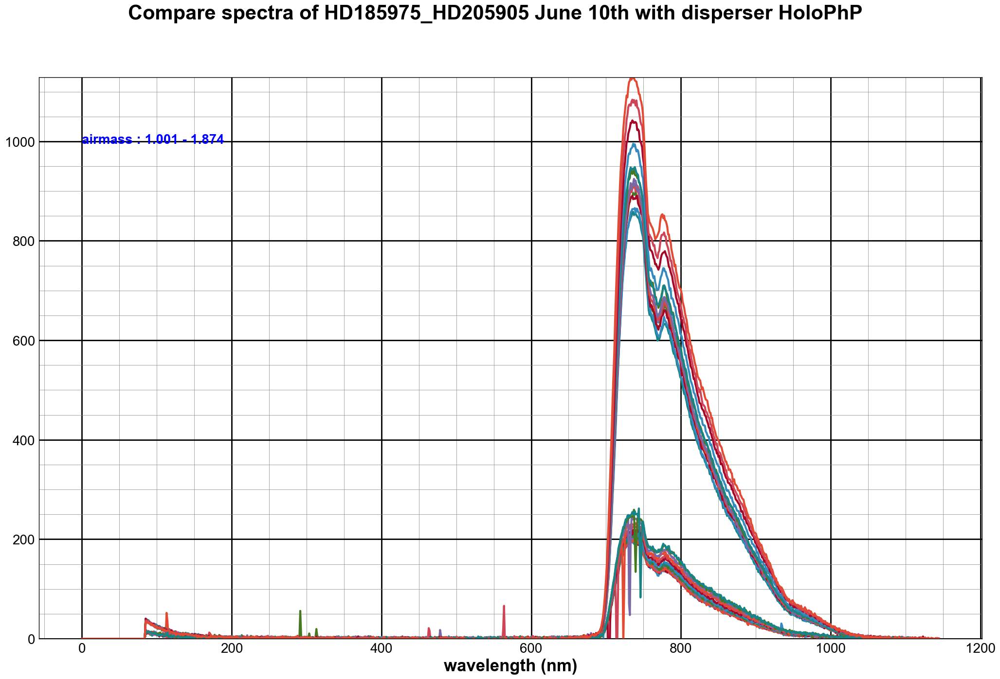

In [62]:
CompareSpectrumProfile(all_wl_right,all_rightspectra,all_titles,object_name,all_filt,dir_top_images,ListOfDisperserNames[1])

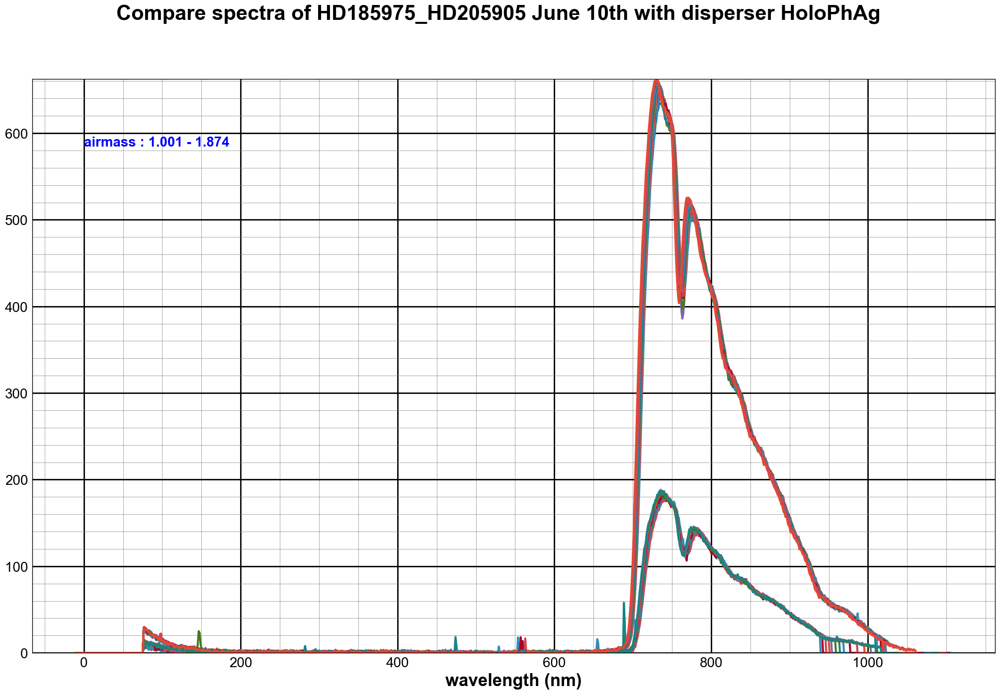

In [63]:
CompareSpectrumProfile(all_wl_right,all_rightspectra,all_titles,object_name,all_filt,dir_top_images,ListOfDisperserNames[2])

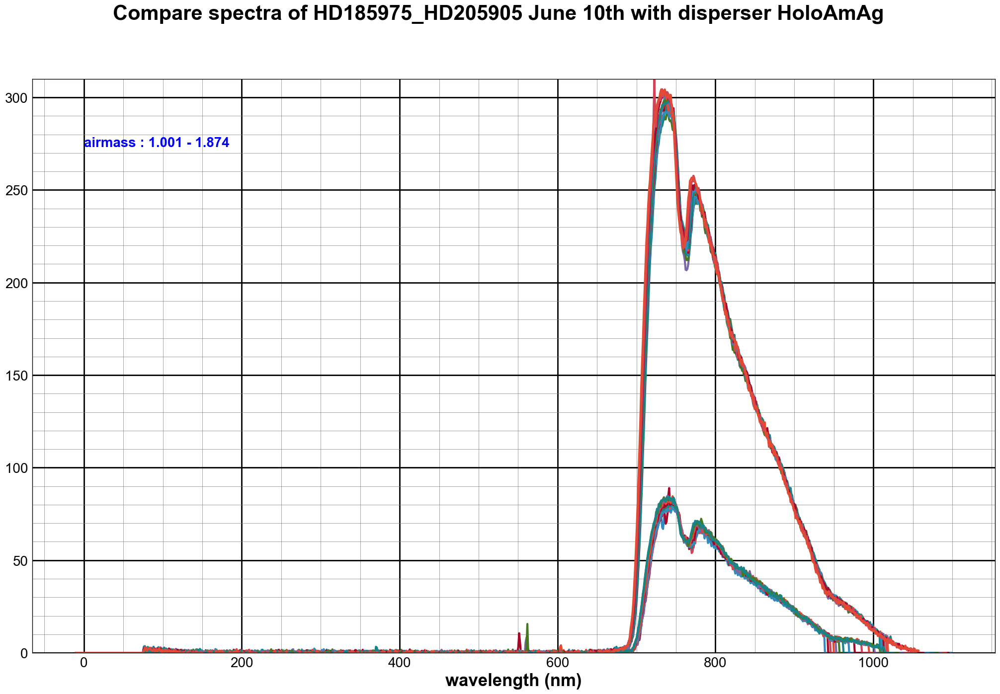

In [64]:
CompareSpectrumProfile(all_wl_right,all_rightspectra,all_titles,object_name,all_filt,dir_top_images,ListOfDisperserNames[3])

In [65]:
#CompareSpectrumProfile(all_wl_right,all_rightspectra,all_titles,object_name,all_filt,dir_top_images,ListOfDisperserNames[4])

# Compute statistical error

In [66]:
print all_elecgain

[3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0, 3.0]


In [67]:
print all_expo

[30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0, 30.0, 30.0, 60.0, 60.0]


In [68]:
def ComputeStatisticalError(all_wl,all_spectra,all_totspectra,all_titles,object_name,all_filt,dir_top_img,figname,gain,expositiontime):
    """
    ComputeStatisticalError : 
    
    """
    NBSPEC=len(all_spectra)
    NBIMGPERROW=2
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
   
    all_stastistical_errors = []    
        
     # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    
    figfilename=os.path.join(dir_top_img,figname)
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Calibrated spectra with stat errors for {}'.format(object_name)
         
    
    
    for index in np.arange(0,NBSPEC):
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20,fontweight='bold')
 
  


        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        wl=all_wl[index]  # wavelength in data
        
        spectrum=np.array(all_spectra[index])   # data
        totspectrum=np.array(all_totspectra[index])
        staterrors=np.sqrt(totspectrum)/np.sqrt(gain[index]*expositiontime[index])
        
       
        axarr[iy,ix].errorbar(wl,spectrum,yerr=staterrors,fmt='o',color='red',lw=2,label='data') # plot data
        
        
        all_stastistical_errors.append(staterrors)
        
        max_y_to_plot=spectrum[:].max()*1.2
        
        max_y_to_plot=max_y_to_plot*0.15
        
        
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
        axarr[iy,ix].set_xlim(0.,1200.)
        axarr[iy,ix].text(0.,max_y_to_plot*1.1/1.2, all_filt[index],verticalalignment='top', horizontalalignment='left',color='blue',fontweight='bold', fontsize=20)
       
        axarr[iy,ix].set_title(all_titles[index])
        
        axarr[iy,ix].set_xlabel("wavelength (nm)")
        
        axarr[iy,ix].get_xaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        axarr[iy,ix].get_yaxis().set_minor_locator(mpl.ticker.AutoMinorLocator())
        axarr[iy,ix].grid(b=True, which='major', color='k', linewidth=2.0)
        axarr[iy,ix].grid(b=True, which='minor', color='grey', linewidth=0.5)
      
        axarr[iy,ix].legend()
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
            
                
          
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()
    return all_stastistical_errors
    
    

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:39: RuntimeWarning: invalid value encountered in sqrt


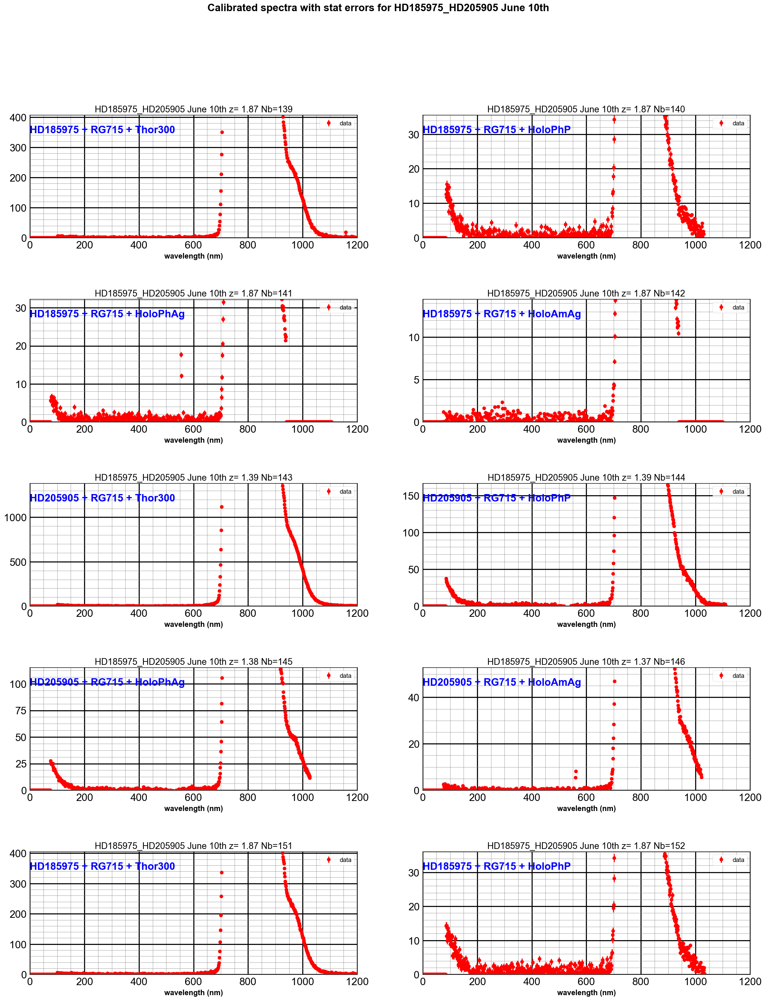

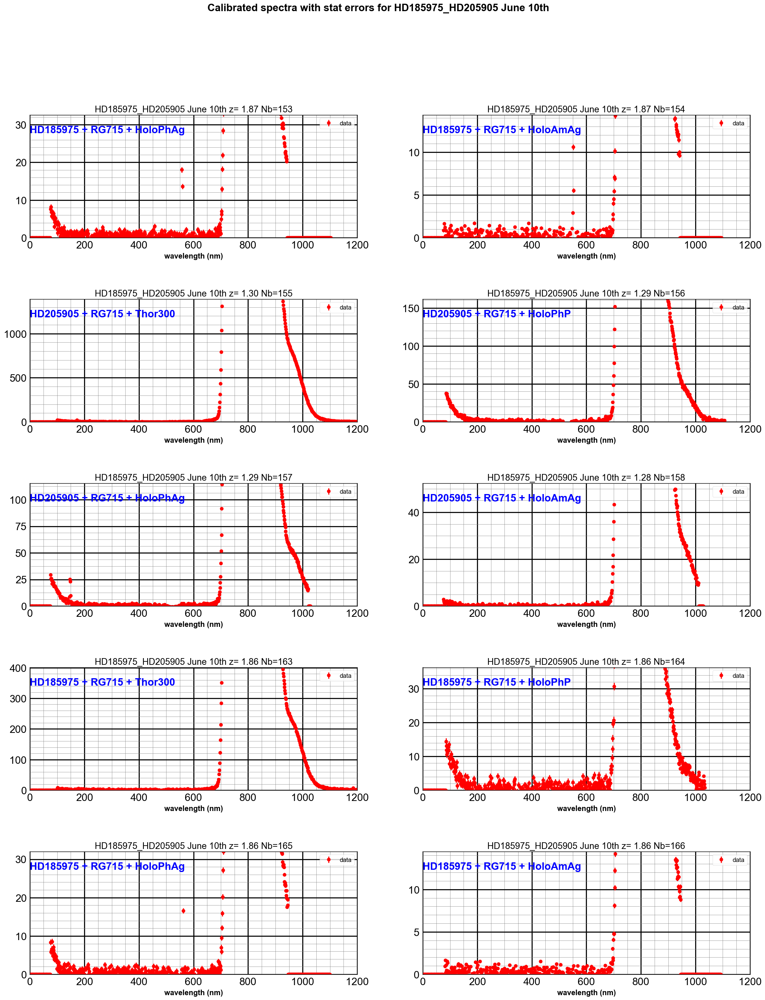

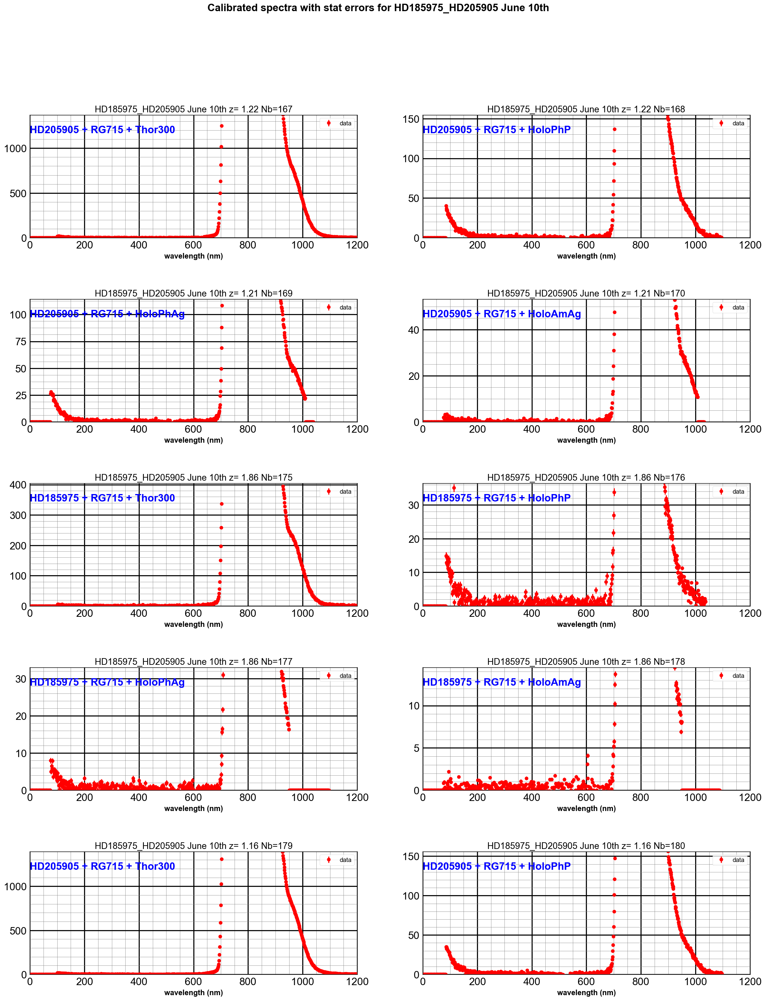

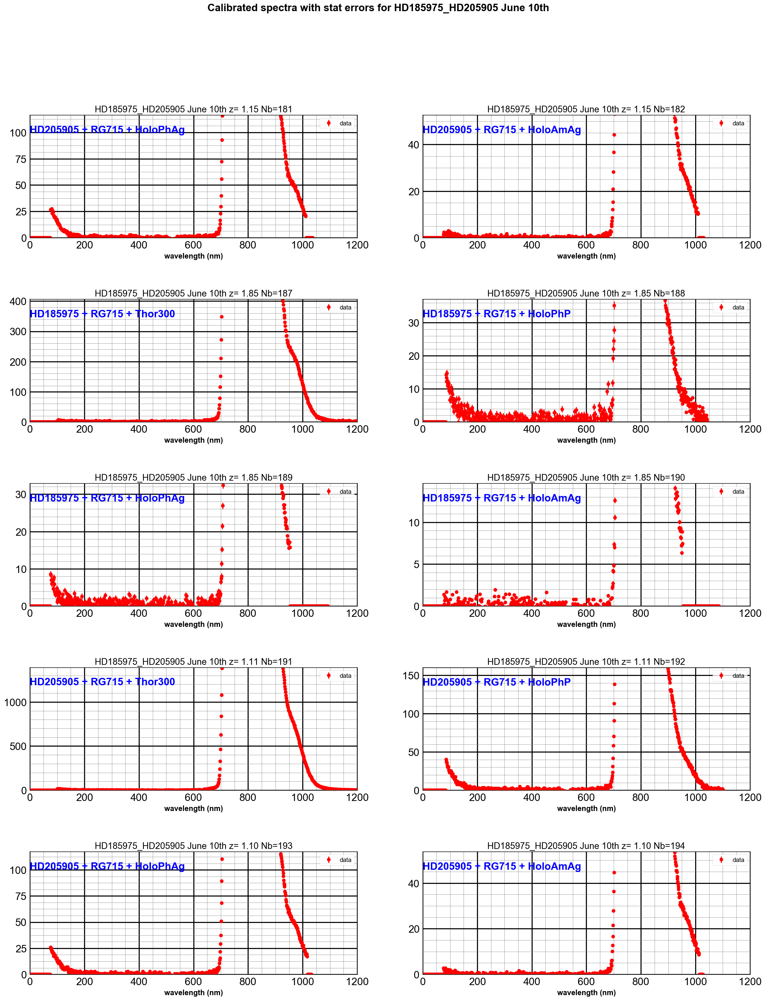

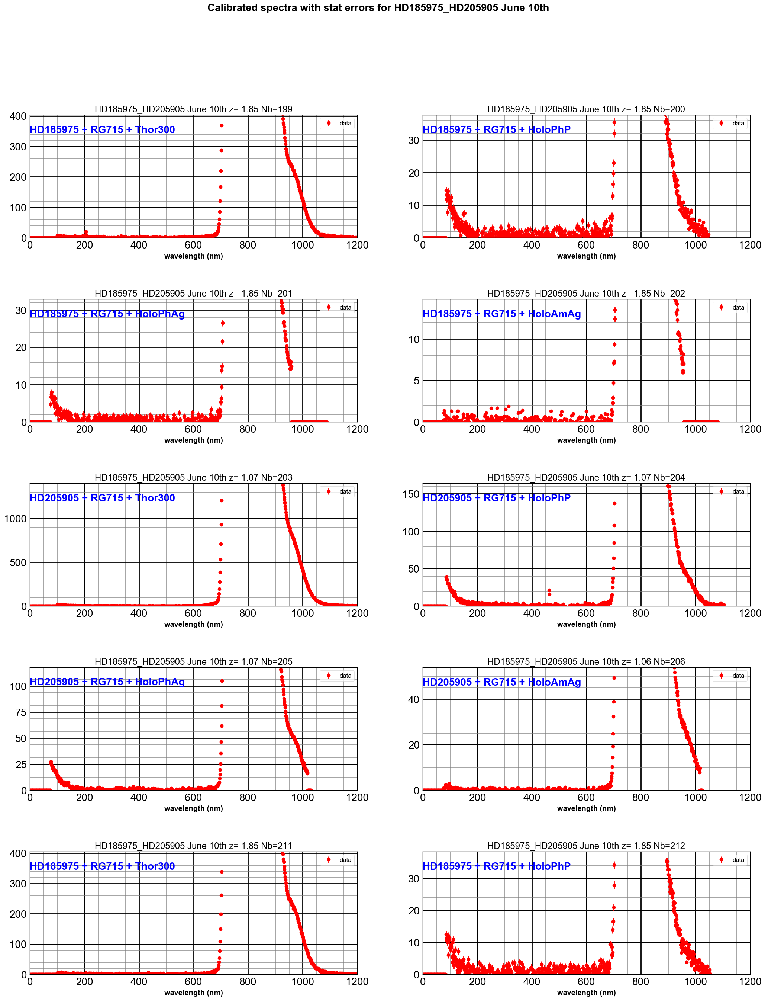

...

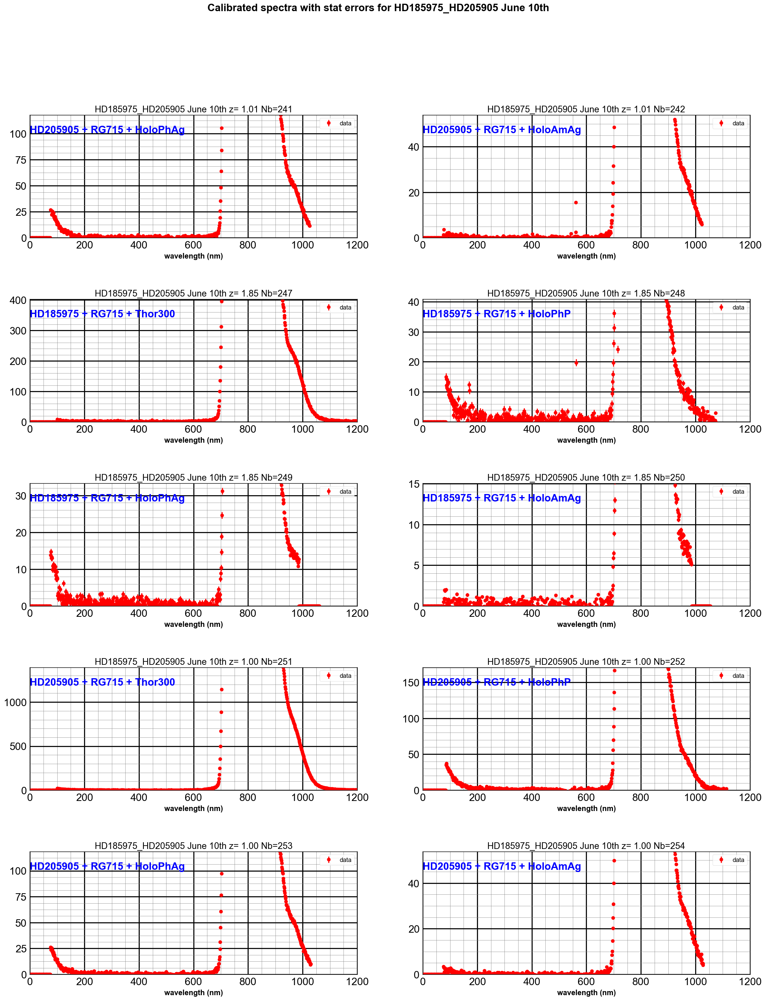

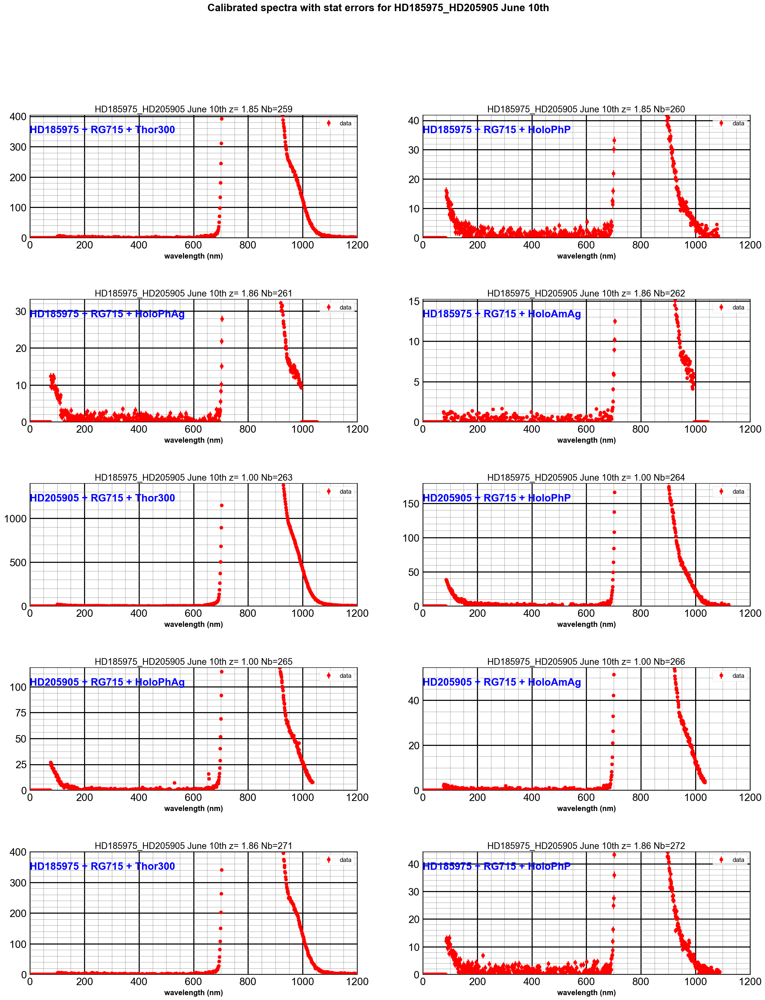

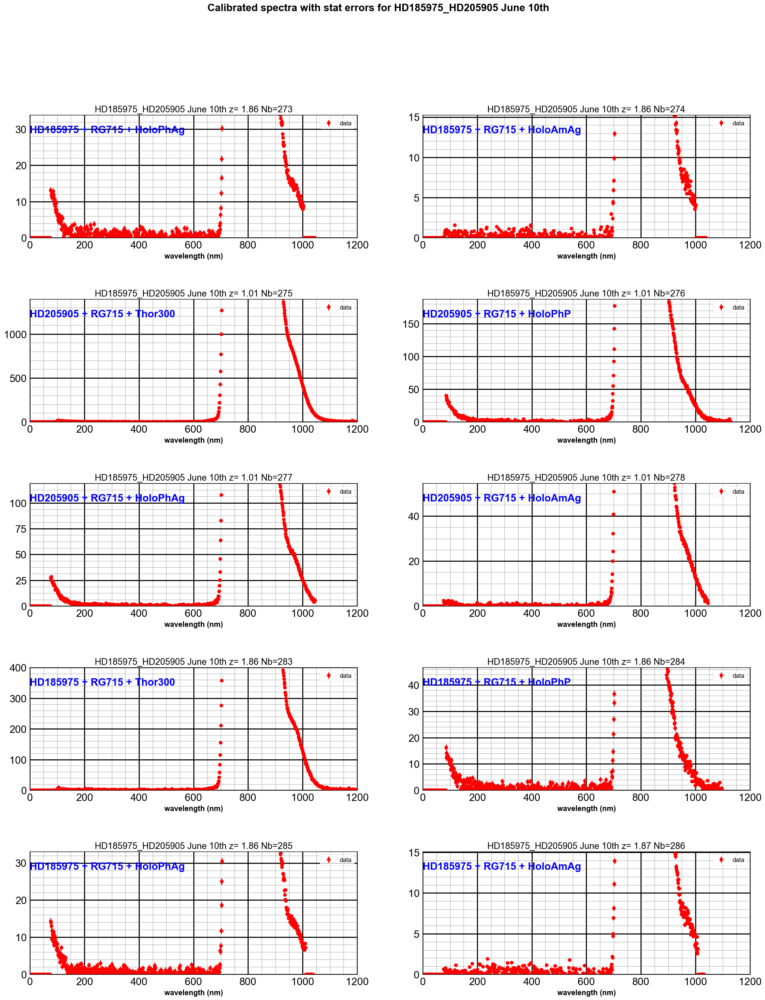

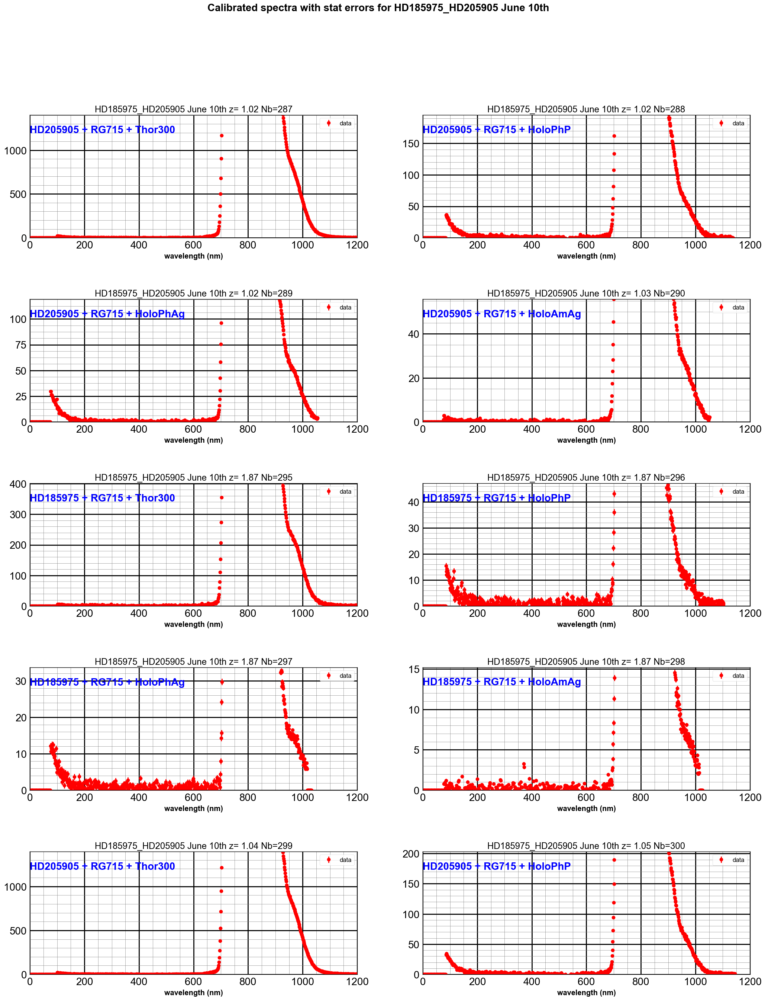

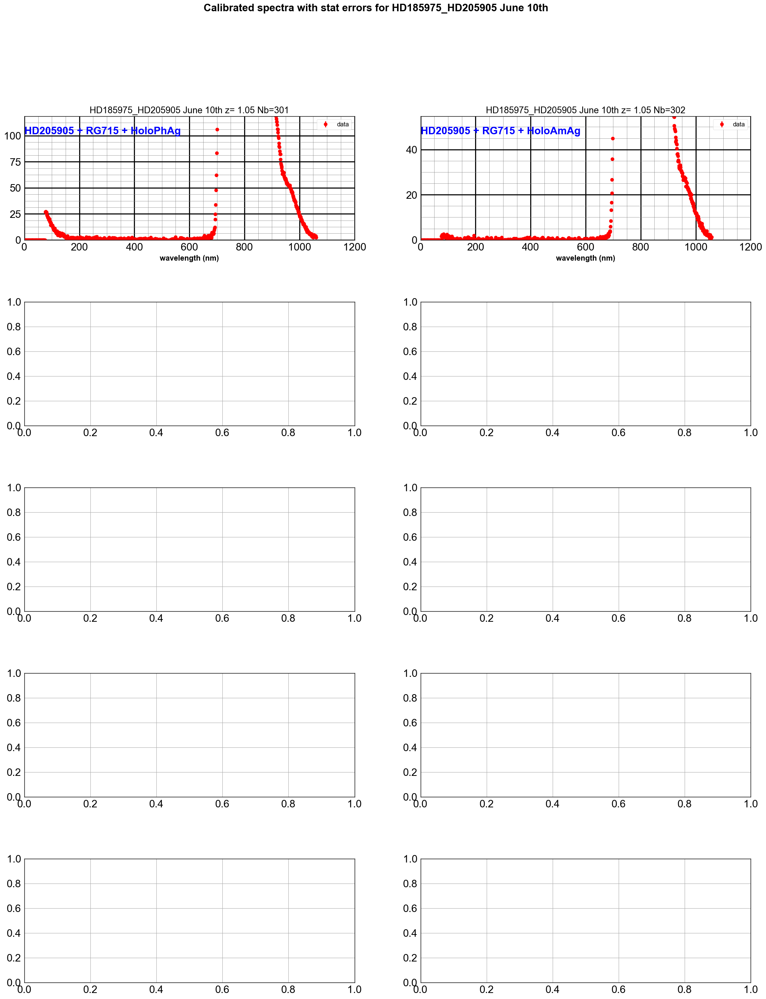

In [69]:
all_rightstastistical_errors=ComputeStatisticalError(all_wl_right,all_rightspectra,all_totrightspectra,all_titles,object_name,all_filt,dir_top_images,'RightSpectraStatErrors.pdf',all_elecgain,all_expo)

/Users/dagoret-campagnesylvie/anaconda/envs/pyastrophys/lib/python2.7/site-packages/ipykernel/__main__.py:39: RuntimeWarning: invalid value encountered in sqrt


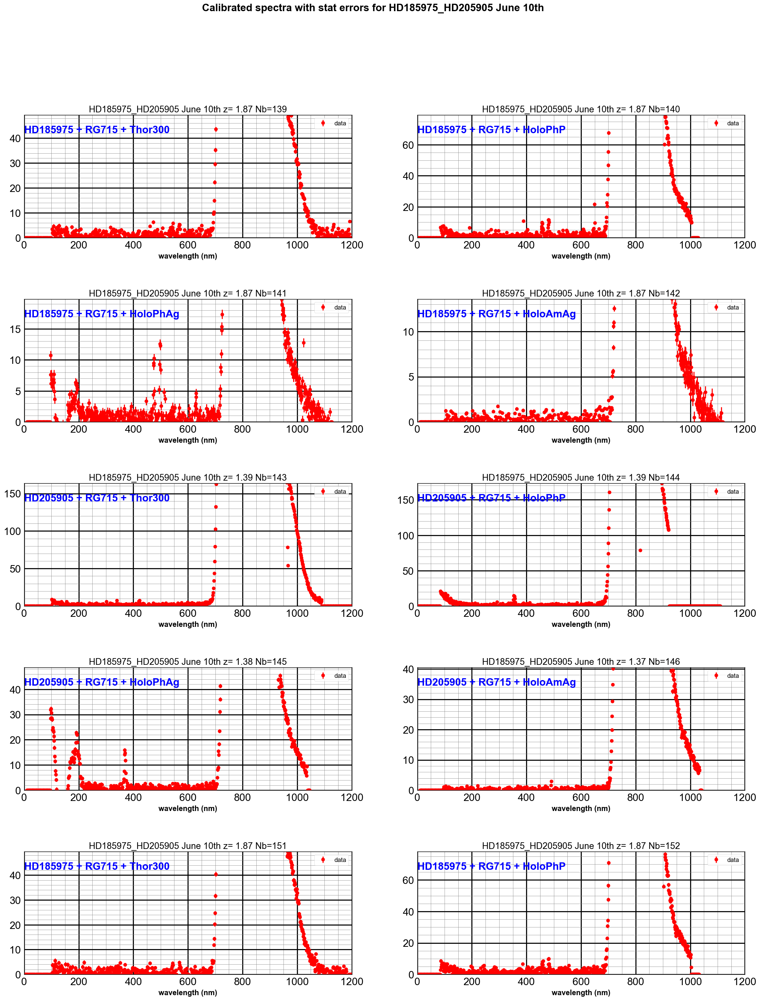

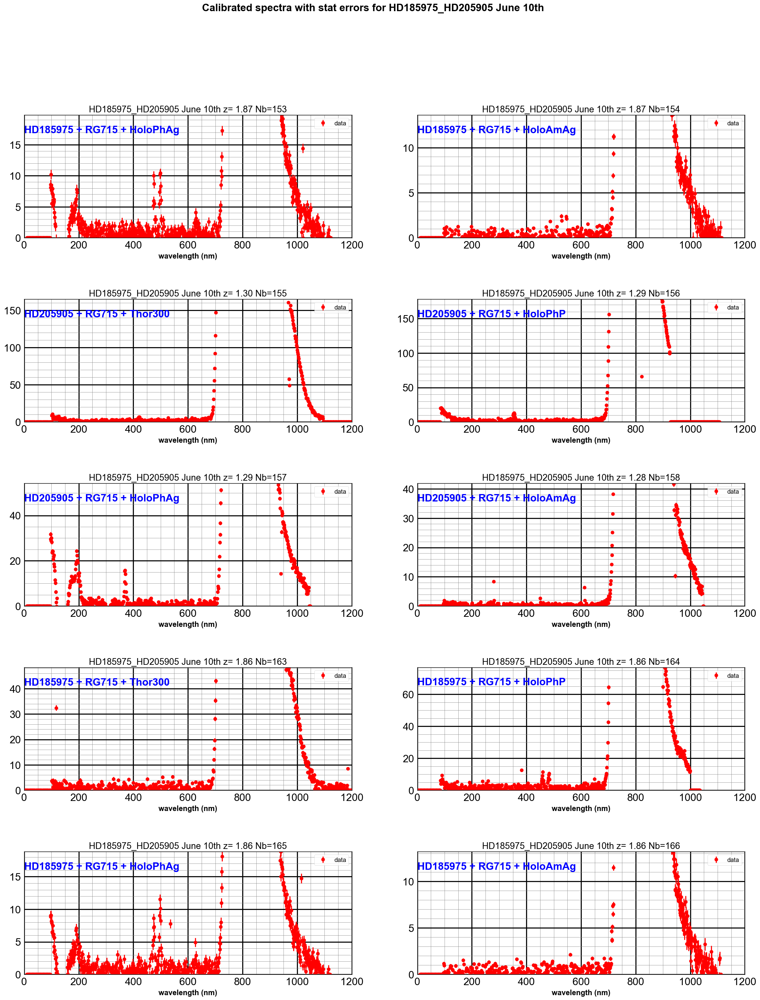

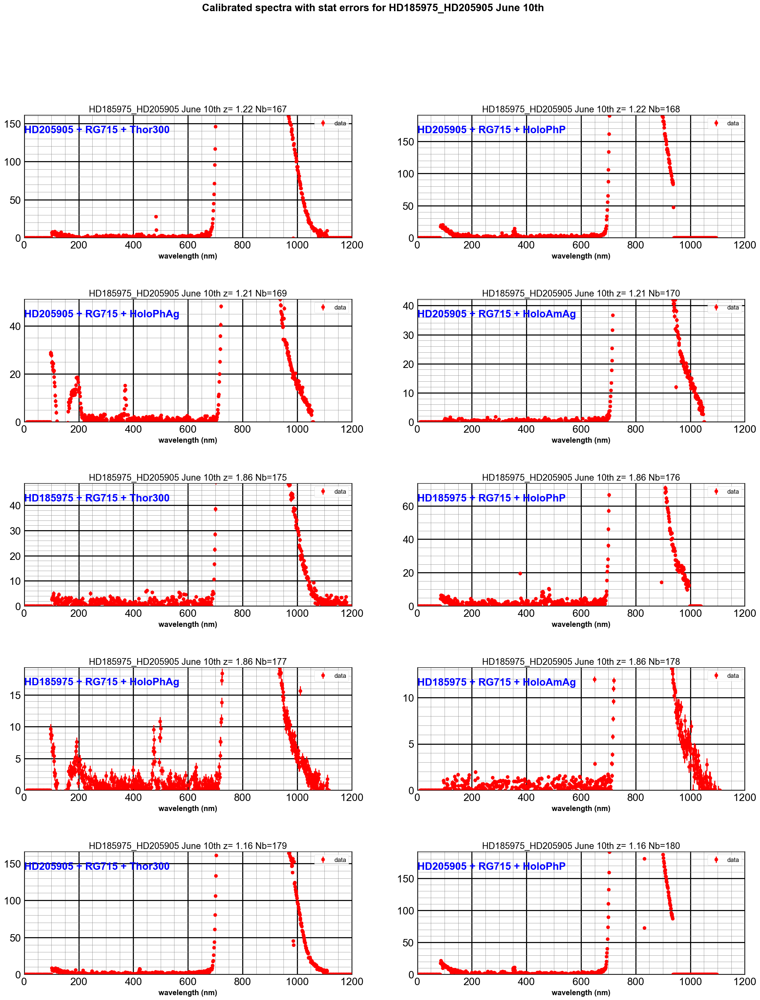

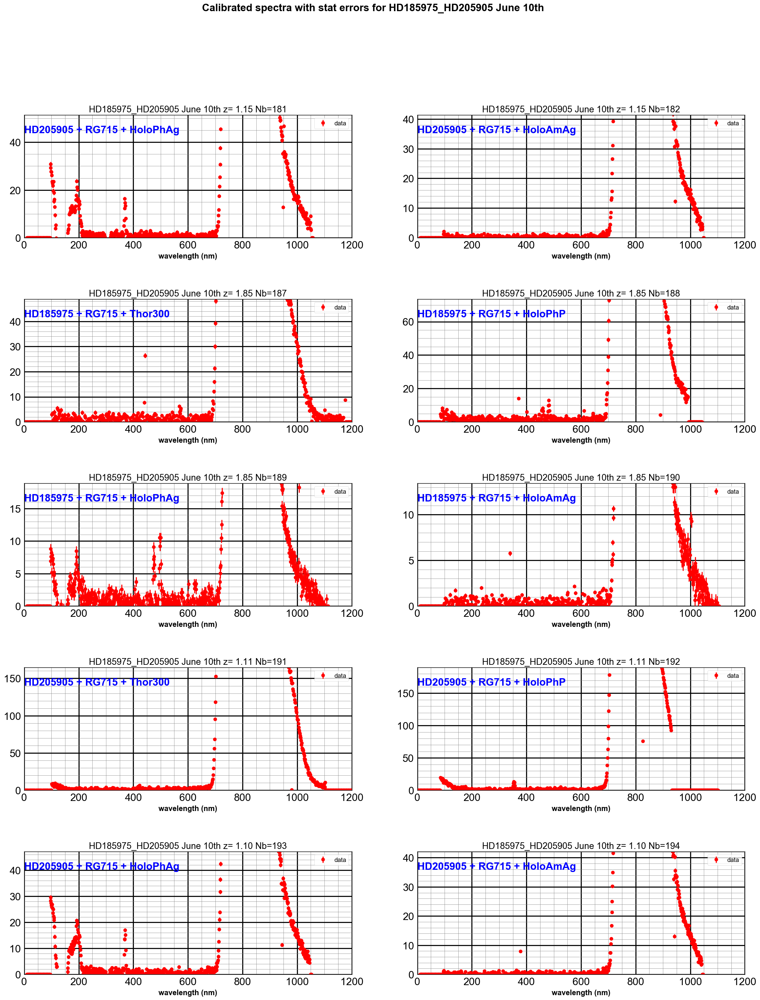

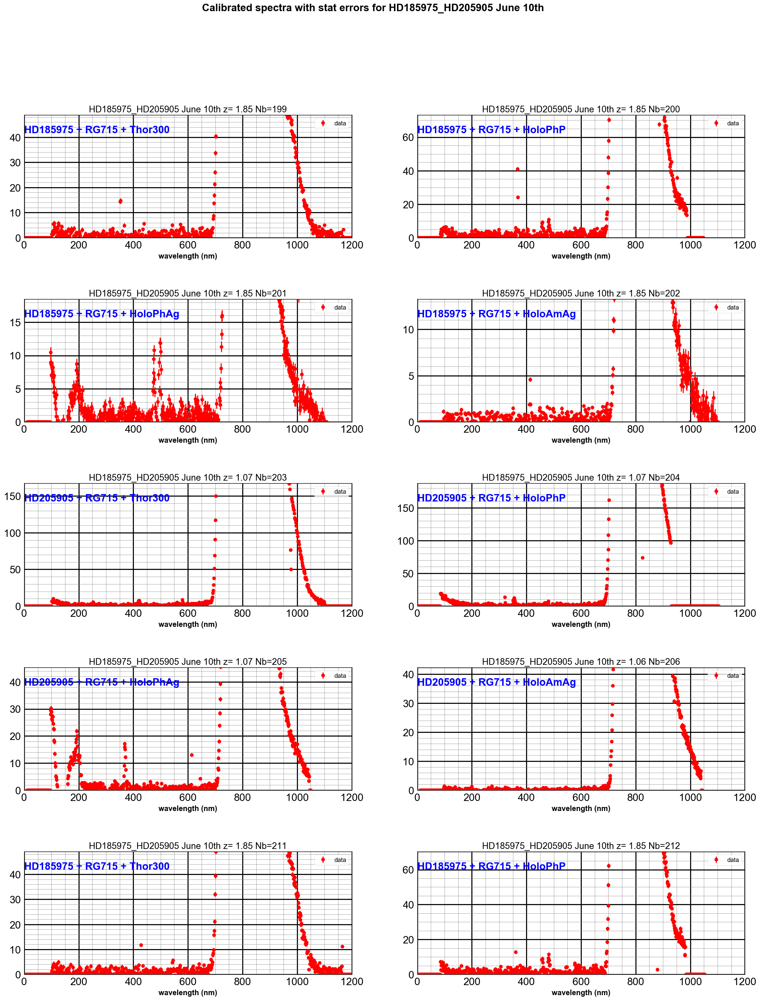

...

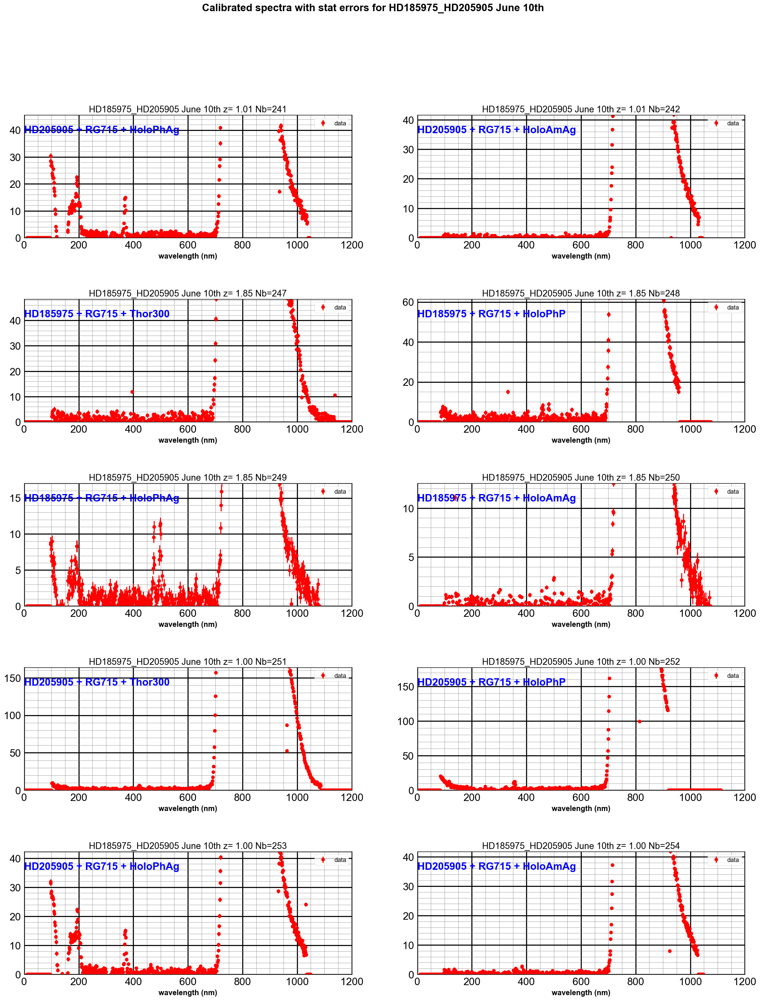

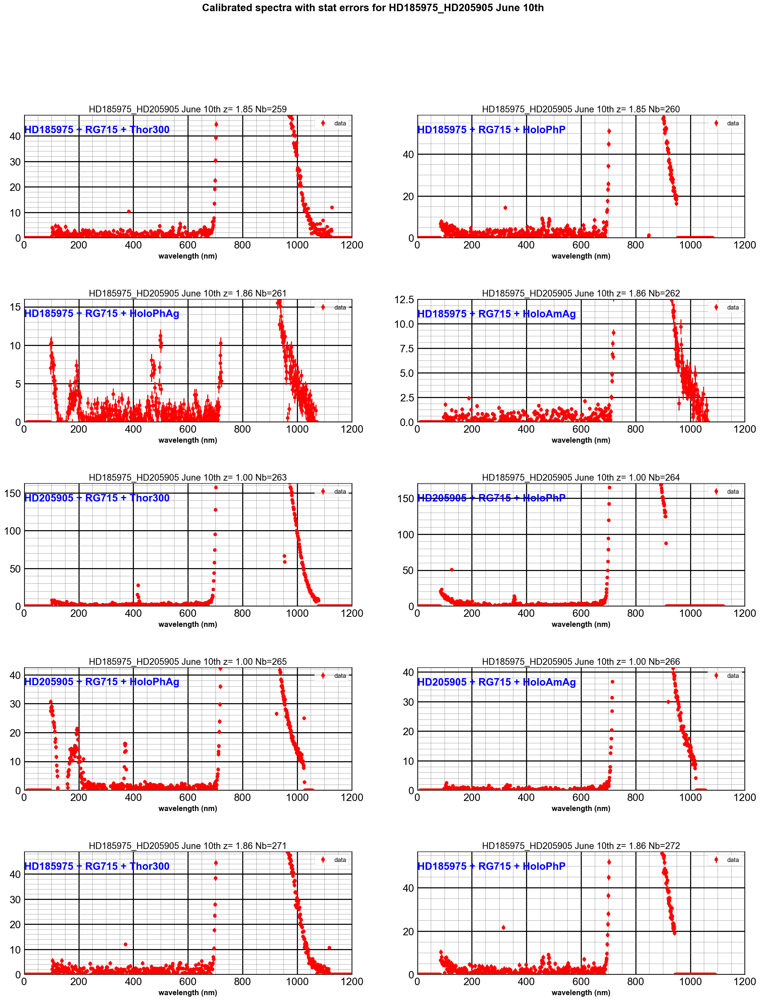

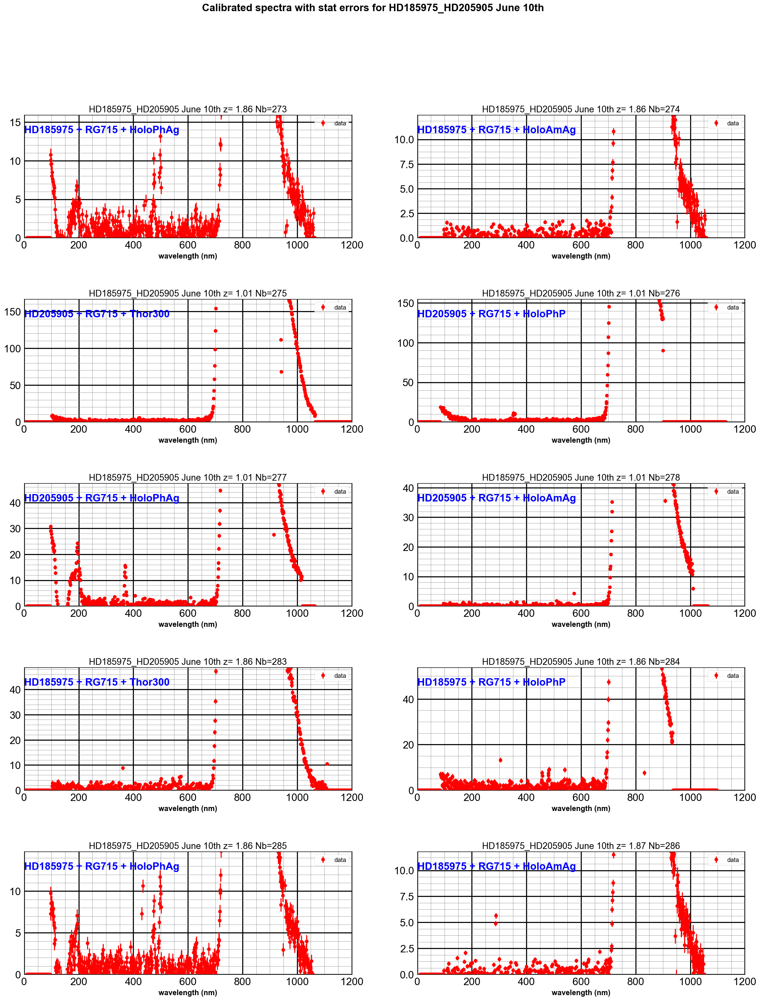

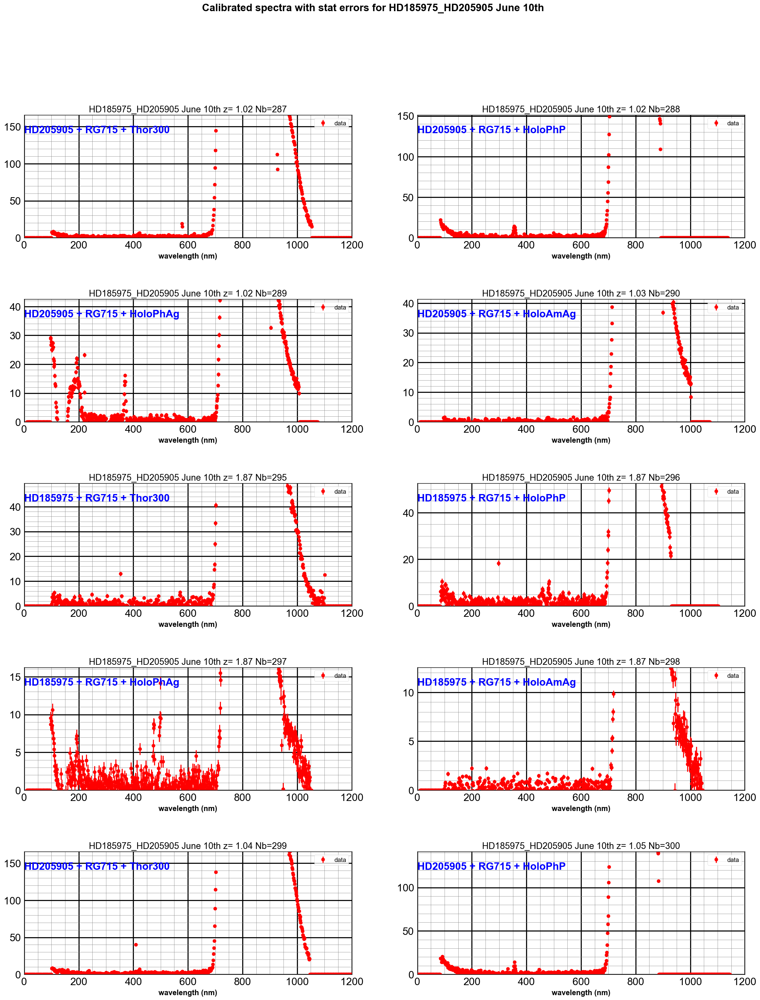

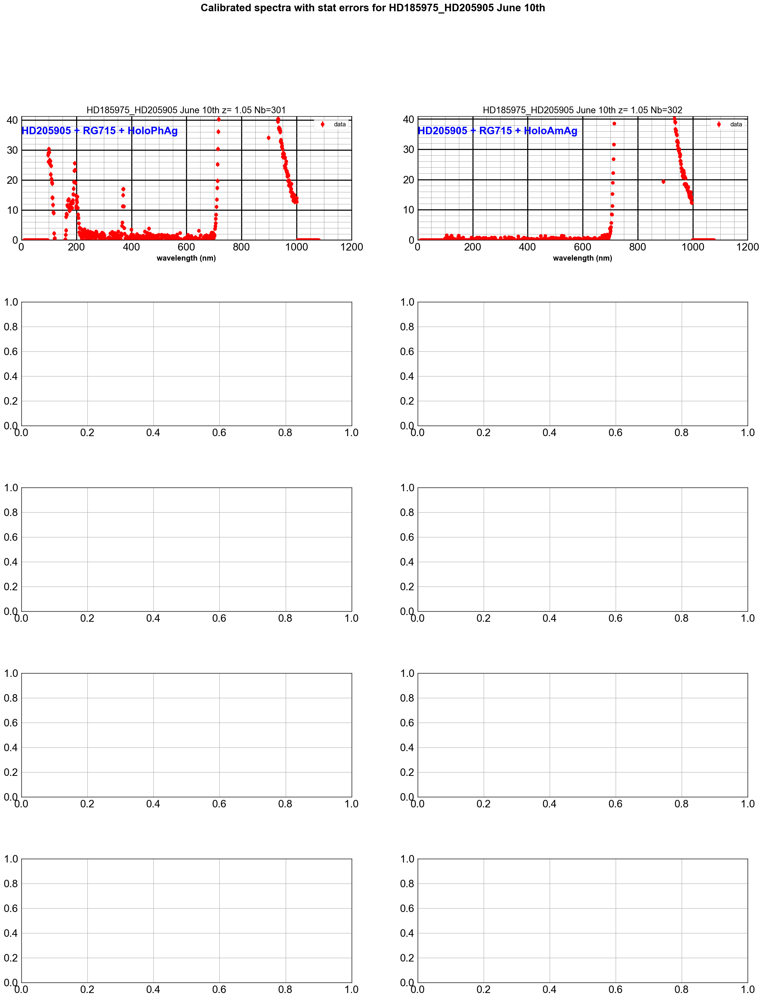

In [70]:
all_leftstastistical_errors=ComputeStatisticalError(all_wl_left,all_leftspectra,all_totleftspectra,all_titles,object_name,all_filt,dir_top_images,'LeftSpectraStatErrors.pdf',all_elecgain,all_expo)

# Save outputfilename
Results of the fits for right and left spectra are saved as images

In [71]:
newfullfilenames=[]
for idx,file in np.ndenumerate(sorted_files):
    short_infilename=file.split("/")[2]
    short_partfilename=re.findall('^finalSpectra_(.*)',short_infilename)
    short_outfilename='calibSpectra_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)

In [72]:
newfullfilenames[0:5]

['./spectrum_calibspec/calibSpectra_20170610_139.fits',
 './spectrum_calibspec/calibSpectra_20170610_140.fits',
 './spectrum_calibspec/calibSpectra_20170610_141.fits',
 './spectrum_calibspec/calibSpectra_20170610_142.fits',
 './spectrum_calibspec/calibSpectra_20170610_143.fits']

In [73]:
#
#  New fashion to save a binary table outside the primary header
#
for idx,file in np.ndenumerate(newfullfilenames):
    primhdu = fits.PrimaryHDU(header=all_header[idx[0]])   # make an primary HDU without data
    
    col1=fits.Column(name='CalibLeftSpecWL',format='E',array=all_wl_left[idx[0]])
    col2=fits.Column(name='CalibLeftSpec',format='E',array=all_leftspectra[idx[0]])
    col3=fits.Column(name='CalibTotLeftSpec',format='E',array=all_totleftspectra[idx[0]])
    col4=fits.Column(name='CalibRightSpecWL',format='E',array=all_wl_right[idx[0]])
    col5=fits.Column(name='CalibRightSpec',format='E',array=all_rightspectra[idx[0]])
    col6=fits.Column(name='CalibTotRightSpec',format='E',array=all_totrightspectra[idx[0]])
    col7=fits.Column(name='CalibStatErrorLeftSpec',format='E',array=all_leftstastistical_errors[idx[0]])
    col8=fits.Column(name='CalibStatErrorRightSpec',format='E',array=all_rightstastistical_errors[idx[0]])
    cols=fits.ColDefs([col1,col2,col3,col4,col5,col6,col7,col8])
   
    
    tbhdu = fits.BinTableHDU.from_columns(cols)     # new binary table HDU
    thdulist = fits.HDUList([primhdu, tbhdu])
    
    thdulist.writeto(file,overwrite=True)

In [74]:
!ls -l ./spectrum_calibspec

total 10744
-rw-r--r--  1 dagoret-campagnesylvie  staff  46080 Jul  7 12:41 calibSpectra_20170610_139.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  46080 Jul  7 12:41 calibSpectra_20170610_140.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  46080 Jul  7 12:41 calibSpectra_20170610_141.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  46080 Jul  7 12:41 calibSpectra_20170610_142.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  48960 Jul  7 12:41 calibSpectra_20170610_143.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  48960 Jul  7 12:41 calibSpectra_20170610_144.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  46080 Jul  7 12:41 calibSpectra_20170610_145.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  46080 Jul  7 12:41 calibSpectra_20170610_146.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  46080 Jul  7 12:41 calibSpectra_20170610_151.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  46080 Jul  7 12:41 calibSpectra_20170610_152.fits
-rw-r--r--  1 dagoret-campagnesylvie  